In [1]:
############# 0. ABRO DATOS #############

#Librerias
import os
import pandas as pd

#Directorios
cwd = os.getcwd()
print("Current working directory: {0}".format(cwd))
#si estoy trabajando desde el servidor vegeta
ruta_a_archivos_smn = "/pikachu/datos/nadia.testani/Doctorado/datos/smn/smn_variables_1961-2021/" #ruta donde estan los archivos con datos del smn
ruta_a_archivo_estaciones_smn = "/pikachu/datos/nadia.testani/Doctorado/datos/smn/" 
ruta_a_resultados = "/pikachu/datos/nadia.testani/Doctorado/resultados/resultados2023/radiacion" #ruta donde se guardan los resultados del analisis de nubosidad

#Abro datos
from f_abrir_datos_smn import abrir_datos_smn
nombres_archivos = os.listdir(ruta_a_archivos_smn)
datos_smn = {}
for nombre_archivo in nombres_archivos:
    id_data = abrir_datos_smn(ruta_a_archivos = ruta_a_archivos_smn, nombre_archivo = nombre_archivo, 
                              variable = "helio")
    datos_smn[id_data[0]] = id_data[1]
    
#Abro archivo con informacion sobre estaciones SMN
estaciones_smn = pd.read_excel(f"{ruta_a_archivo_estaciones_smn}Exp185151.xlsx", sheet_name = "Estaciones", 
                               names = ["EST", "NOMBRE", "LAT", "LON", "ALT"]) #smn

# Corrijo puntos manualmente 
#monte caseros
estaciones_smn.loc[estaciones_smn.EST == 87393, 'LAT'] = 30.27078
estaciones_smn.loc[estaciones_smn.EST == 87393, 'LON'] = 57.64046
#reconquista aero
estaciones_smn.loc[estaciones_smn.EST == 87270, 'LAT'] = 29.20159
estaciones_smn.loc[estaciones_smn.EST == 87270, 'LON'] = 59.69280
#paso de los libres aero
estaciones_smn.loc[estaciones_smn.EST == 87289, 'LAT'] = 29.68796
estaciones_smn.loc[estaciones_smn.EST == 87289, 'LON'] = 57.15317
#posadas aero
estaciones_smn.loc[estaciones_smn.EST == 87178, 'LAT'] = 27.39170
estaciones_smn.loc[estaciones_smn.EST == 87178, 'LON'] = 55.96673
#corrientes aero
estaciones_smn.loc[estaciones_smn.EST == 87166, 'LAT'] = 27.44915
estaciones_smn.loc[estaciones_smn.EST == 87166, 'LON'] = 58.75830
#concordia aero
estaciones_smn.loc[estaciones_smn.EST == 87395, 'LAT'] = 31.30297
estaciones_smn.loc[estaciones_smn.EST == 87395, 'LON'] = 58.00242
#resistencia aero
estaciones_smn.loc[estaciones_smn.EST == 87155, 'LAT'] = 27.44478
estaciones_smn.loc[estaciones_smn.EST == 87155, 'LON'] = 59.04856
#obera
estaciones_smn.loc[estaciones_smn.EST == 87187, 'LAT'] = 27.48733
estaciones_smn.loc[estaciones_smn.EST == 87187, 'LON'] = 55.12099
#roque saenz peña
estaciones_smn.loc[estaciones_smn.EST == 87148, 'LAT'] = 26.74565
estaciones_smn.loc[estaciones_smn.EST == 87148, 'LON'] = 60.48277
#mercedes
estaciones_smn.loc[estaciones_smn.EST == 87281, 'LAT'] = -29.22248
estaciones_smn.loc[estaciones_smn.EST == 87281, 'LON'] = -58.08762
#ituzaingo 
estaciones_smn.loc[estaciones_smn.EST == 87173, 'LAT'] = -27.58890
estaciones_smn.loc[estaciones_smn.EST == 87173, 'LON'] = -56.68925

Current working directory: /home/nadia.testani/Doctorado/codigos/codigos2023


In [2]:
############# 1. COMPUTO DATOS DIARIOS FALTANTES #############
#extraigo la fecha de la primer y ultima medicion y calculo porcentaje de datos faltantes y lo acomodo en una tabla
import datetime as dt

print(f"CREATE TABLE INFO HELIOFANIA")
print("\n")
codigos = list(estaciones_smn.EST)
nombres = ["Mercedes Aero", "Monte Caseros Aero", "Reconquista Aero", "Paso de los Libres Aero",
           "Posadas Aero", "Corrientes Aero", "Concordia Aero", "Resistencia Aero", "Ituzaingó", 
           "Oberá", "Presidencia Roque Saenz Peña Aero"]
lons = list(round(estaciones_smn.LON, 3))
lats = list(round(estaciones_smn.LAT,3))
alts = list(estaciones_smn.ALT)
fechas_0 = [str(datos_smn[cod].index[0].month) +"/" + str(datos_smn[cod].index[0].year) for cod in codigos]
fechas_menos1 = [str(datos_smn[cod].index[-1].month) +"/" + str(datos_smn[cod].index[-1].year) for cod in codigos]
porcentajes_faltantes = [round(datos_smn[cod].isnull()["helio"].sum()/len(datos_smn[cod]["helio"])*100, 3) for cod in codigos]

#defino fechas climatologicas y para estudios a largo plazo, sale de trabajo con nubosidad
fechas_climatologicas = pd.date_range(start="1983-12-01",end="2016-11-30")
fechas_largo_plazo = pd.date_range(start="1961-03-01",end="2021-02-28")

porcentajes_faltantes_1983_2016 = [round(datos_smn[cod]["1983-12-01":"2016-11-30"].isnull()["helio"].sum()/len(fechas_climatologicas)*100, 3) for cod in codigos]
porcentajes_faltantes_1961_2021 = [round(datos_smn[cod]["1961-03-01":"2021-02-28"].isnull()["helio"].sum()/len(fechas_largo_plazo)*100, 3) for cod in codigos]

tabla_info_estaciones = pd.DataFrame({"Name": nombres,
                                      "Code": codigos,
                                      "Longitude [º]": lons,
                                      "Latitude [º]": lats,
                                      "Elevation [m]": alts,
                                      "Initial Date [mm/yyyy]":fechas_0,
                                      "Final Date [mm/yyyy]":fechas_menos1,
                                      f"Missing values (Initial-Final Date) [%]": porcentajes_faltantes,
                                      f"Missing values (1983-12-01 - 2016-11-30) [%]": porcentajes_faltantes_1983_2016,
                                      f"Missing values (1961-03-01 - 2021-02-28) [%]": porcentajes_faltantes_1961_2021})

#tabla_info_estaciones[["Name","Missing values (Initial-Final Date) [%]",
#                      "Missing values (1983-12-01 - 2016-11-30) [%]",
#                      "Missing values (1961-03-01 - 2021-02-28) [%]"]]

tabla_info_estaciones

CREATE TABLE INFO HELIOFANIA




,Name,Code,Longitude [º],Latitude [º],Elevation [m],Initial Date [mm/yyyy],Final Date [mm/yyyy],Missing values (Initial-Final Date) [%],Missing values (1983-12-01 - 2016-11-30) [%],Missing values (1961-03-01 - 2021-02-28) [%]
0,Mercedes Aero,87281,-58.088,-29.222,107,1/1961,11/2021,96.639,99.975,96.861
1,Monte Caseros Aero,87393,57.640,30.271,54,1/1961,11/2021,16.962,15.762,16.053
2,Reconquista Aero,87270,59.693,29.202,53,1/1961,11/2021,4.324,6.985,4.385
3,Paso de los Libres Aero,87289,57.153,29.688,70,1/1961,11/2021,7.653,7.632,7.762
4,Posadas Aero,87178,55.967,27.392,125,1/1961,11/2021,7.352,11.863,7.456
5,Corrientes Aero,87166,58.758,27.449,62,11/1961,11/2021,9.155,8.130,8.008
6,Concordia Aero,87395,58.002,31.303,38,10/1962,11/2021,19.460,8.354,19.170
7,Resistencia Aero,87155,59.049,27.445,52,7/1964,11/2021,8.039,8.495,7.680
8,Ituzaingó,87173,-56.689,-27.589,72,7/1962,11/2021,67.864,55.011,66.936
9,Oberá,87187,55.121,27.487,303,1/1961,11/2021,99.991,99.992,99.995


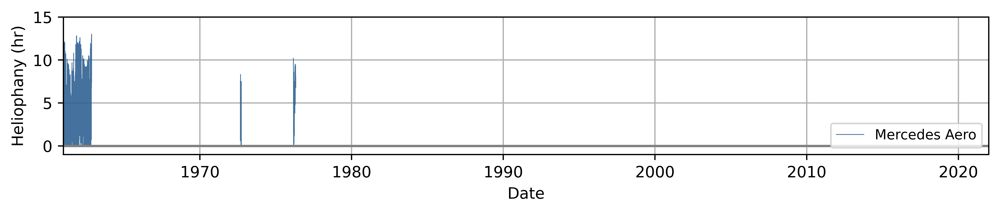

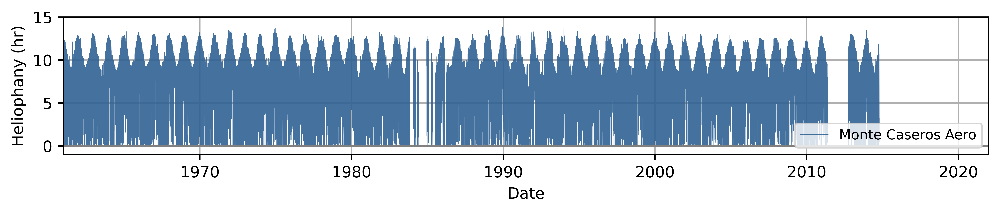

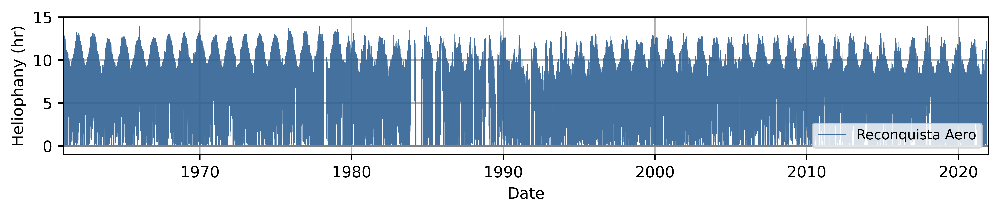

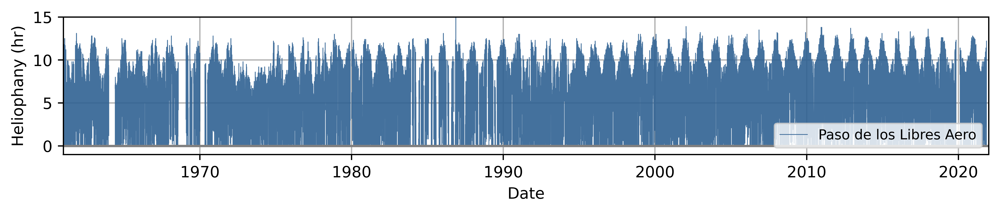

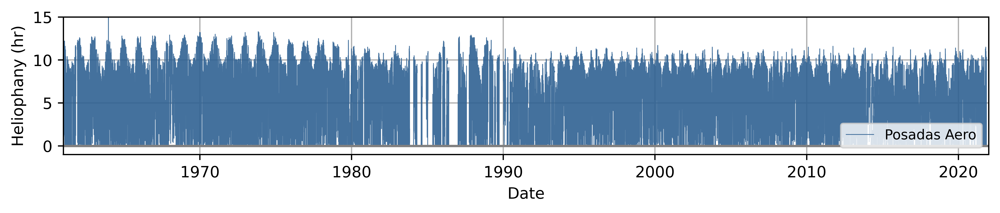

...

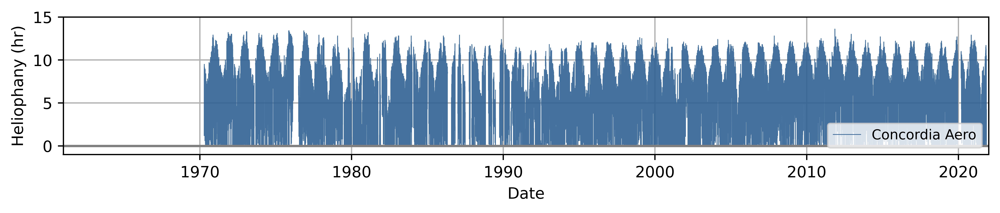

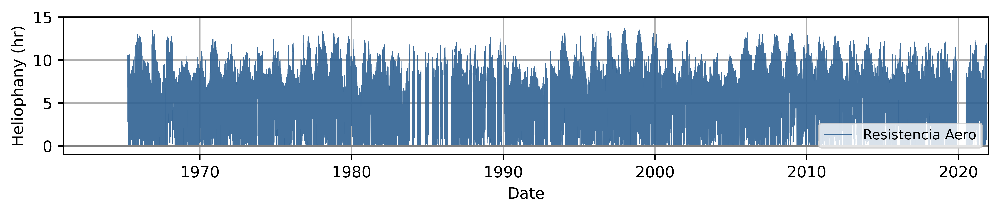

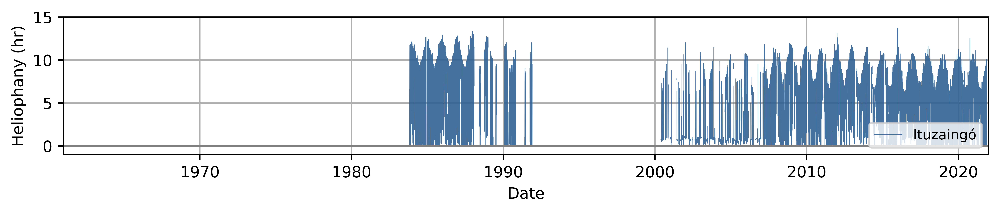

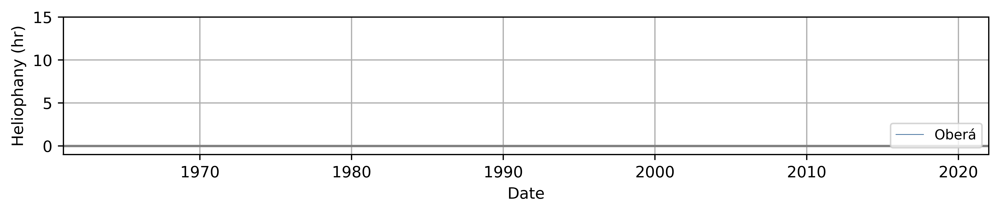

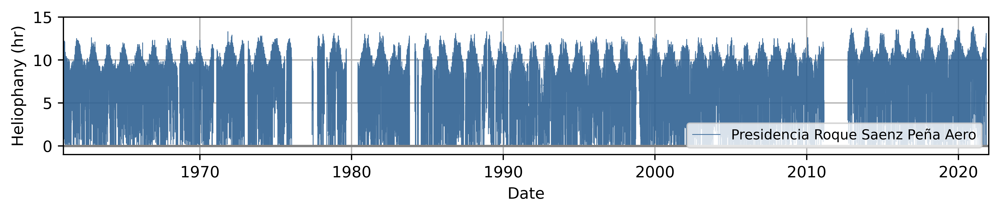

In [3]:
############# 1. GRAFICO SERIES DIARIAS PARA VER DONDE ESTAN LOS DATOS FALTANTES #############
import matplotlib.pyplot as plt

#figura
def f_plot_control_calidad(num):
    fig = plt.figure(num=1, figsize=(9, 2), dpi=900) #(9, 2)
    plt.subplot(1, 1, 1)
    plt.plot(datos_smn[tabla_info_estaciones["Code"][num]], color = "#306292", linewidth = 0.5, alpha = 0.9)
    ylim = 15
    plt.ylim((-1,ylim))
    plt.ylabel("Heliophany (hr)")
    plt.xlim((dt.datetime(year=1961,month=1, day=1),dt.datetime(year=2022,month=1, day=1)))
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.legend([tabla_info_estaciones["Name"][num]], loc ="lower right", ncol=2, prop={'size': 8.8})
    plt.grid()
    plt.tight_layout()
    return(fig)

for num in range(0,11):
    f_plot_control_calidad(num)
    plt.show()

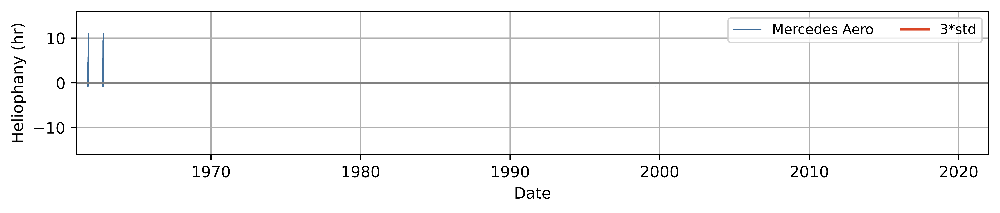

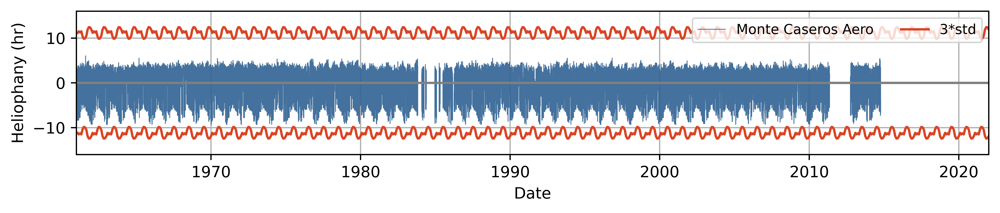

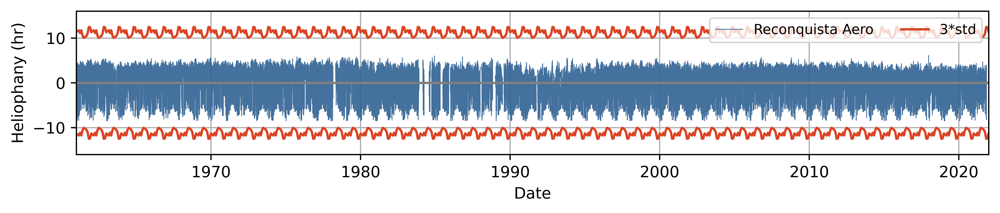

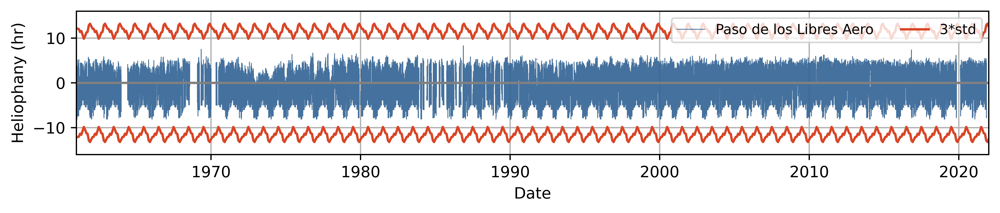

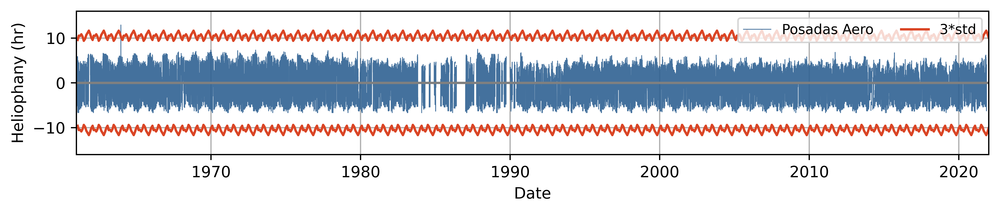

...

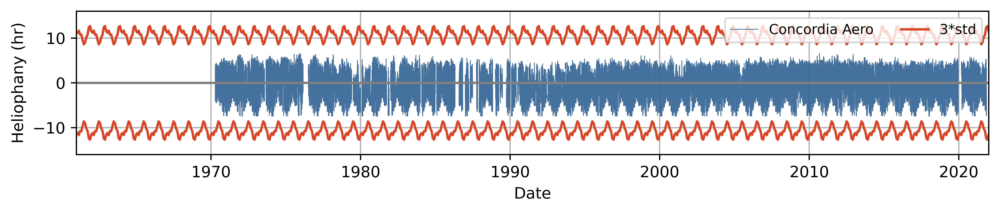

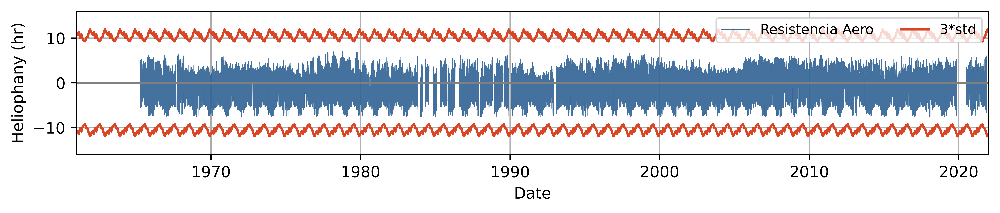

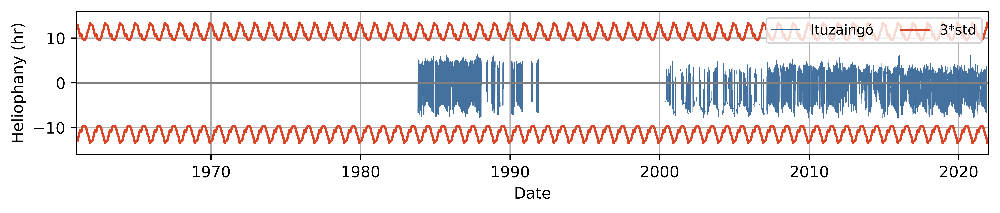

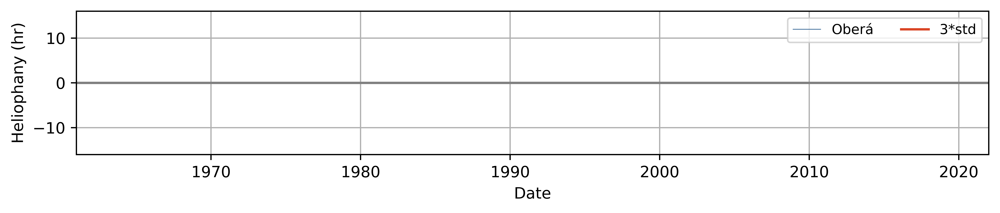

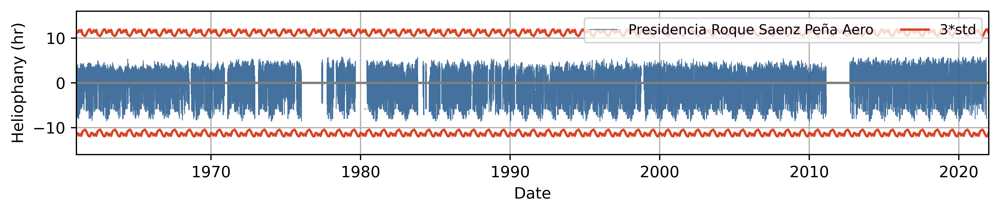

In [4]:
############# 2. VEO OUTLIERS #############
import numpy as np
import matplotlib.pyplot as plt

#calculo la climatologia de los valores diarios: media y desvio climatologica mensual de los datos diarios
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
climatologia_mensual_media_datos_diarios_smn = {} 
climatologia_mensual_desvio_datos_diarios_smn = {}
for id_omm in tabla_info_estaciones["Code"]: #para cada id_omm_ordenado
    diarios_df = datos_smn[id_omm]
    diarios_df.index = pd.to_datetime(diarios_df.index)
    diarios_fechas_climatologia = diarios_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    diarios_df_climatologia_media = diarios_fechas_climatologia.groupby(diarios_fechas_climatologia.index.month).mean() 
    diarios_df_climatologia_desvio = diarios_fechas_climatologia.groupby(diarios_fechas_climatologia.index.month).std() 
    #Lo guardo en diccionarios
    climatologia_mensual_media_datos_diarios_smn[id_omm] = diarios_df_climatologia_media
    climatologia_mensual_desvio_datos_diarios_smn[id_omm] = diarios_df_climatologia_desvio
    
#estimo valor-media
#veo si es mayor a 3*desvio o menor a -3*desvio
series_diario_anom = {}
for num in range(0,11):
    cod = tabla_info_estaciones["Code"][num]
    serie_diario = datos_smn[cod]
    serie_diario_anom = serie_diario.copy()
    for mes in range(1,13):
        serie_diario_anom[serie_diario_anom.index.month == mes] = serie_diario[serie_diario.index.month == mes] - float(climatologia_mensual_media_datos_diarios_smn[cod].loc[mes])
    series_diario_anom[cod] = serie_diario_anom
    
#genero serie de + tres veces el desvio y - tres veces el desvio
#fechas_1961_2020_mensual = dt.datetime(year=1961,month=1, day=1),dt.datetime(year=2022,month=1, day=1))

fechas_1961_2020_mensual = pd.date_range(start="1961-01",end="2022-01", freq = "M")
cant_anios = int(len(fechas_1961_2020_mensual)/12)
series_desvios_mens = {}
for num in range(0,11):
    cod = tabla_info_estaciones["Code"][num]
    desvios = pd.concat([climatologia_mensual_desvio_datos_diarios_smn[cod]]*cant_anios)
    desvios.index = fechas_1961_2020_mensual
    series_desvios_mens[cod] = desvios

#Grafico series 
def f_plot_control_calidad_3(num):
    fig = plt.figure(num=1, figsize=(9, 2), dpi=900)
    plt.subplot(1, 1, 1)
    plt.plot(series_diario_anom[tabla_info_estaciones["Code"][num]], color = "#306292", linewidth = 0.5, alpha = 0.9)
    plt.plot(3*series_desvios_mens[tabla_info_estaciones["Code"][num]], color = "#DA4525")
    plt.plot(-3*series_desvios_mens[tabla_info_estaciones["Code"][num]], color = "#DA4525")
    ylim = 16
    plt.ylim((-ylim,ylim))
    plt.ylabel("Heliophany (hr)")
    plt.xlim((dt.datetime(year=1961, month=1, day=1),dt.datetime(year=2022,month=1, day=1)))
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.legend([tabla_info_estaciones["Name"][num],"3*std"], loc ="upper right", ncol=2, prop={'size': 8.8})
    plt.grid()
    plt.tight_layout()
    return(fig)

for num in range(0,11):
    f_plot_control_calidad_3(num)
    plt.show()
    
#Identifico un outlier en Posadas
serie_anom_diario = series_diario_anom[87178]
##si le resto tres veces el desvio queda mayor a 0? --> outlier
#veo_out = serie_anom_diario[serie_anom_diario.index.month == 1] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 1]))
#veo_out = serie_anom_diario[serie_anom_diario.index.month == 2] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 2]))
#veo_out = serie_anom_diario[serie_anom_diario.index.month == 3] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 3]))
#veo_out = serie_anom_diario[serie_anom_diario.index.month == 4] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 4]))
#veo_out = serie_anom_diario[serie_anom_diario.index.month == 5] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 5]))
#veo_out = serie_anom_diario[serie_anom_diario.index.month == 6] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 6]))
#veo_out = serie_anom_diario[serie_anom_diario.index.month == 7] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 7]))
#veo_out = serie_anom_diario[serie_anom_diario.index.month == 8] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 8]))
#veo_out = serie_anom_diario[serie_anom_diario.index.month == 9] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 9]))
#veo_out = serie_anom_diario[serie_anom_diario.index.month == 10] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 10]))
#veo_out = serie_anom_diario[serie_anom_diario.index.month == 11] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 11]))
veo_out = serie_anom_diario[serie_anom_diario.index.month == 12] - 3 * float(np.unique(series_desvios_mens[87178][series_desvios_mens[87178].index.month == 12]))
fecha_out = veo_out[(veo_out[veo_out > 0].isnull() == False)["helio"]]
datos_smn[87178][datos_smn[87178].index == fecha_out.index.values[0]] 

#Lo elimino de la serie
datos_smn[87178][datos_smn[87178].index == fecha_out.index.values[0]] = np.nan

In [5]:
############# 3. VEO INHOMOGENEIDADES #############

#Visualmente: Roque Saenz Peña 87148
#TEST YAMAMOTO

#separo la serie de datos diarios en dos periodos: 1 antes del salto y otro despues del salto
#del mismo largo
#el salto visualmente lo noto despues del periodo de datos faltantes del año 2011-2012
#periodo_1 = 2002-01-02 a 2011-02-23 #3340 dias
#periodo_2 = 2012-09-16 a 2021-11-07 #3340 dias

periodo_1 = pd.date_range(start="2002-01-02", end="2011-02-23",freq="D")
periodo_2 = pd.date_range(start="2012-09-16", end="2021-11-07", freq="D")

#media y desvio periodo 1
media_1 = datos_smn[87148]["2002-01-02":"2011-02-23"].mean()
desvio_1 = datos_smn[87148]["2002-01-02":"2011-02-23"].std()

#media y desvio periodo 2
media_2 = datos_smn[87148]["2012-09-16":"2021-11-07"].mean()
desvio_2 = datos_smn[87148]["2012-09-16":"2021-11-07"].std()

#estadistico
#c = desvio * t_student * 1 / (n-1)
t_student_alpha = 2.33  #grados de libertad > 120, alpha = 0.01
C_1 = desvio_1 * t_student_alpha * 1 / (len(periodo_1)-np.sum(datos_smn[87148]["2002-01-02":"2011-02-23"].isnull()) - 1)
C_2 = desvio_2 * t_student_alpha * 1 / (len(periodo_2)-np.sum(datos_smn[87148]["2012-09-16":"2021-11-07"].isnull()) - 1)
Y = abs(media_1-media_2) / (C_1 + C_2) # Y = 174.478537 --> Y > 1

#homogeinizo la serie: le resto al periodo 2 la diferencia con la media del periodo 1
diferencia_medias_2_1 = media_2 - media_1
datos_smn[87148]["2012-09-16":"2021-11-07"] = datos_smn[87148]["2012-09-16":"2021-11-07"] - diferencia_medias_2_1

In [6]:
############# 4. SERIES MENSUALES #############

#calculo series de medias mensuales de cada estacion
#los meses con mas de 20% de datos faltantes se computan como NA
from f_media_mensual_smn import f_media_mensual_smn 
porcentaje_na_admitido = 20
medias_mensuales_smn = {} #genero diccionario donde se van a guardar las medias mensuales
for id_omm in tabla_info_estaciones["Code"]:
    media_mensual_df = f_media_mensual_smn(id_omm, datos_smn[id_omm], porcentaje_na_admitido, "helio") #uso funcion f_media_mensual_smn en f_paper_nubosidad_NEA
    medias_mensuales_smn[id_omm] = media_mensual_df

In [7]:
############# 4. SERIES MENSUALES --> DATOS FALTANTES#############
import datetime as dt

print(f"CREATE TABLE INFO HELIOFANIA MENSUAL")
print("\n")

codigos = list(estaciones_smn.EST)
nombres = ["Mercedes Aero", "Monte Caseros Aero", "Reconquista Aero", "Paso de los Libres Aero",
           "Posadas Aero", "Corrientes Aero", "Concordia Aero", "Resistencia Aero", "Ituzaingó", 
           "Oberá", "Presidencia Roque Saenz Peña Aero"]
lons = list(round(estaciones_smn.LON, 3))
lats = list(round(estaciones_smn.LAT,3))
alts = list(estaciones_smn.ALT)
fechas_0 = [str(datos_smn[cod].index[0].month) +"/" + str(datos_smn[cod].index[0].year) for cod in codigos]
fechas_menos1 = [str(datos_smn[cod].index[-1].month) +"/" + str(datos_smn[cod].index[-1].year) for cod in codigos]
porcentajes_faltantes = [round(medias_mensuales_smn[cod].isnull()[0].sum()/len(medias_mensuales_smn[cod][0])*100, 3) for cod in codigos]

#defino fechas climatologicas y para estudios a largo plazo, sale de trabajo con nubosidad
fechas_climatologicas = pd.date_range(start="1983-12",end="2016-12", freq = "M")
fechas_largo_plazo = pd.date_range(start="1961-03",end="2021-03", freq = "M")

porcentajes_faltantes_1983_2016 = [round(medias_mensuales_smn[cod]["1983-12":"2016-11"].isnull()[0].sum()/len(fechas_climatologicas)*100, 3) for cod in codigos]
porcentajes_faltantes_1961_2021 = [round(medias_mensuales_smn[cod]["1961-03":"2021-02"].isnull()[0].sum()/len(fechas_largo_plazo)*100, 3) for cod in codigos]

tabla_info_estaciones_mensuales = pd.DataFrame({"Name": nombres,
                                      "Code": codigos,
                                      "Longitude [º]": lons,
                                      "Latitude [º]": lats,
                                      "Elevation [m]": alts,
                                      "Initial Date [mm/yyyy]":fechas_0,
                                      "Final Date [mm/yyyy]":fechas_menos1,
                                      f"Missing monthly values (Initial-Final Date) [%]": porcentajes_faltantes,
                                      f"Missing monthly values (1983-12-01 - 2016-11-30) [%]": porcentajes_faltantes_1983_2016,
                                      f"Missing monthly values (1961-03-01 - 2021-02-28) [%]": porcentajes_faltantes_1961_2021})


#tabla_info_estaciones_mensuales[["Name", "Missing monthly values (Initial-Final Date) [%]",
#                                "Missing monthly values (1983-12-01 - 2016-11-30) [%]",
#                                "Missing monthly values (1961-03-01 - 2021-02-28) [%]"]]

tabla_info_estaciones_mensuales

CREATE TABLE INFO HELIOFANIA MENSUAL




,Name,Code,Longitude [º],Latitude [º],Elevation [m],Initial Date [mm/yyyy],Final Date [mm/yyyy],Missing monthly values (Initial-Final Date) [%],Missing monthly values (1983-12-01 - 2016-11-30) [%],Missing monthly values (1961-03-01 - 2021-02-28) [%]
0,Mercedes Aero,87281,-58.088,-29.222,107,1/1961,11/2021,96.990,100.000,97.222
1,Monte Caseros Aero,87393,57.640,30.271,54,1/1961,11/2021,16.689,15.404,15.694
2,Reconquista Aero,87270,59.693,29.202,53,1/1961,11/2021,4.925,8.081,5.000
3,Paso de los Libres Aero,87289,57.153,29.688,70,1/1961,11/2021,7.524,7.576,7.639
4,Posadas Aero,87178,55.967,27.392,125,1/1961,11/2021,9.302,15.404,9.444
5,Corrientes Aero,87166,58.758,27.449,62,11/1961,11/2021,9.154,8.081,7.917
6,Concordia Aero,87395,58.002,31.303,38,10/1962,11/2021,20.845,10.101,20.556
7,Resistencia Aero,87155,59.049,27.445,52,7/1964,11/2021,8.418,8.838,8.056
8,Ituzaingó,87173,-56.689,-27.589,72,7/1962,11/2021,74.334,67.677,73.333
9,Oberá,87187,55.121,27.487,303,1/1961,11/2021,100.000,100.000,100.000


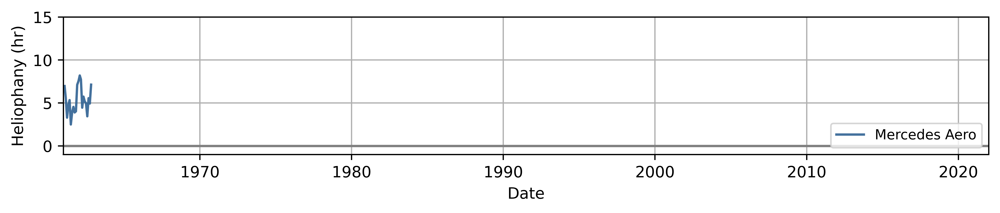

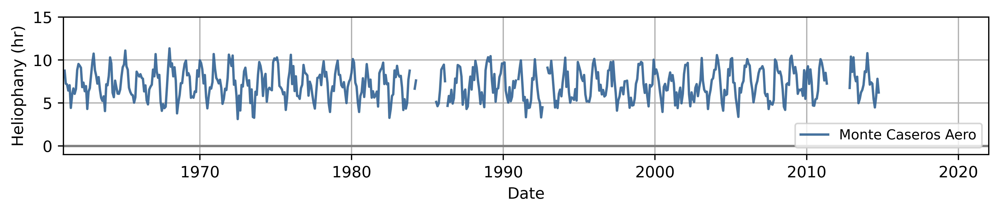

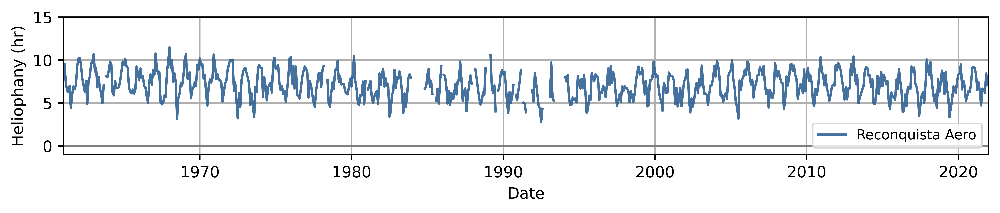

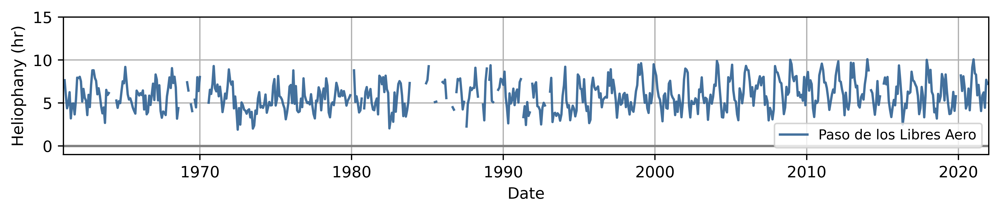

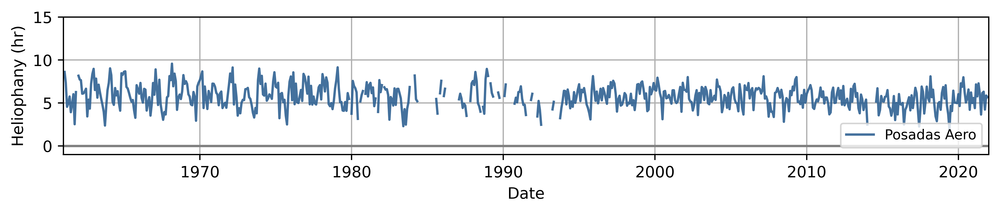

...

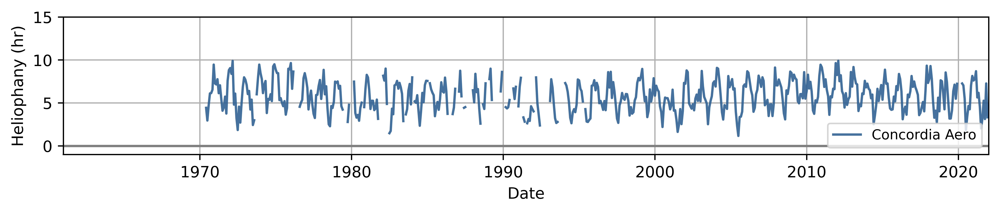

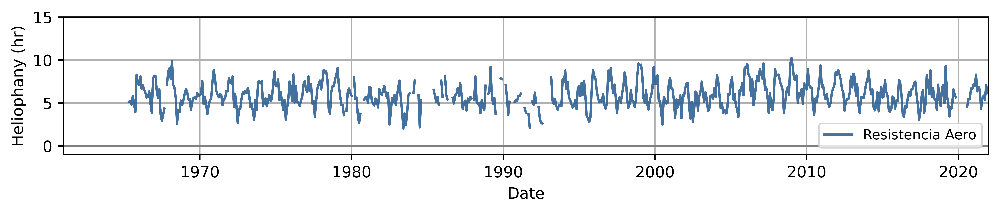

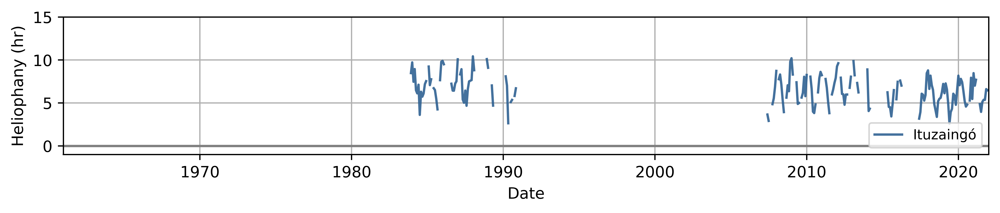

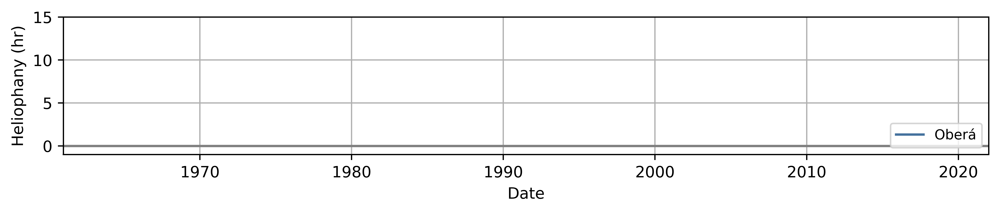

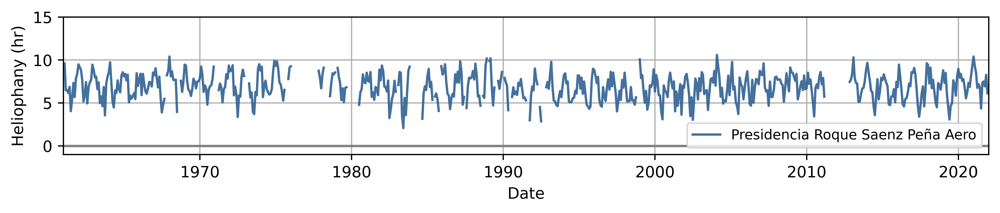

In [8]:
############# 4. SERIES MENSUALES --> GRAFICOS#############
import matplotlib.pyplot as plt

#figura
def f_plot_control_calidad_2(num):
    fig = plt.figure(num=1, figsize=(9, 2), dpi=900)
    plt.subplot(1, 1, 1)
    plt.plot(medias_mensuales_smn[tabla_info_estaciones["Code"][num]], color = "#306292", linewidth = 1.5, alpha = 0.9)
    ylim = 15
    plt.ylim((-1,ylim))
    plt.ylabel("Heliophany (hr)")
    plt.xlim((dt.datetime(year=1961,month=1, day=1),dt.datetime(year=2022,month=1, day=1)))
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.legend([tabla_info_estaciones["Name"][num]], loc ="lower right", ncol=2, prop={'size': 8.8})
    plt.grid()
    plt.tight_layout()
    return(fig)

for num in range(0,11):
    f_plot_control_calidad_2(num)
    plt.show()    

In [9]:
########### FIN CONTROL DE CALIDAD ##########
#Trabajo con series mensuales de todas las estaciones excepto: Mercedes Aero, Ituzaingó y Oberá

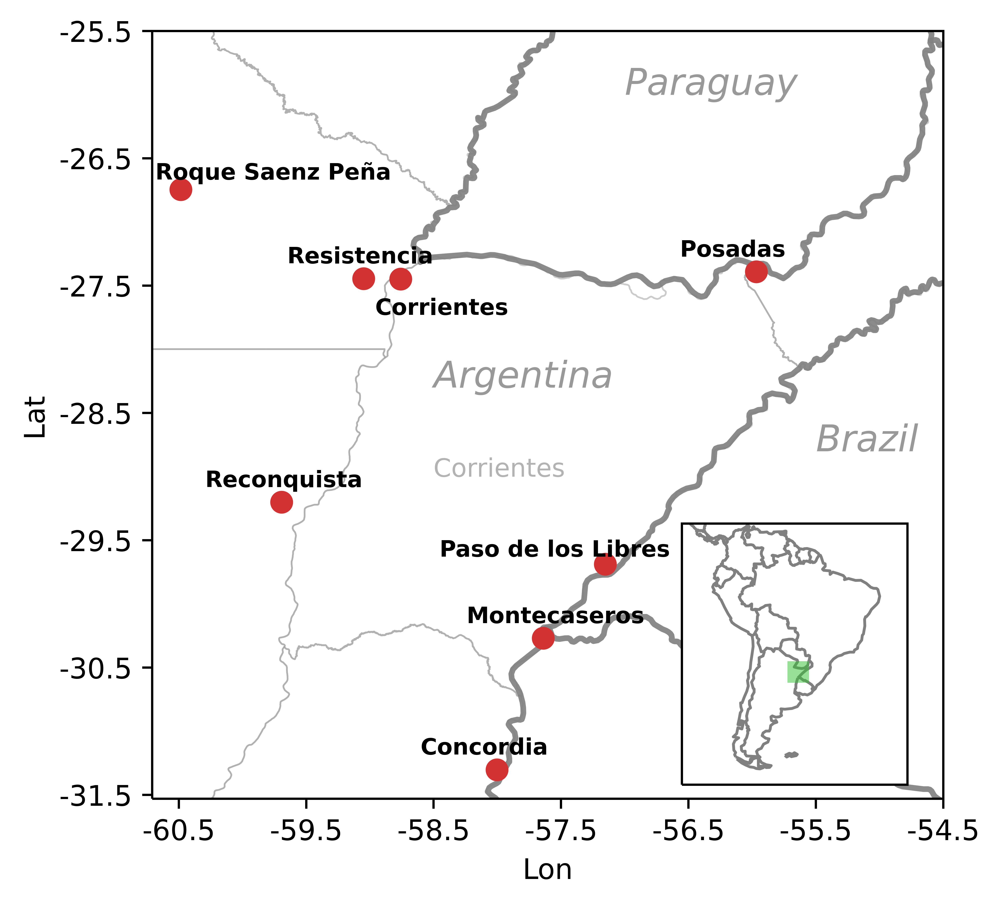

In [10]:
########### 1. MAPA CON ESTACIONES ##########
import warnings
warnings.filterwarnings("ignore") #para que muestre los warnings una sola vez

from f_mis_shapes import df_paises, df_provincias
from f_mapa import f_mapa

lista_puntos_smn = [(360 - lon, -1 * lat) for lon, lat in zip(estaciones_smn["LON"],estaciones_smn["LAT"])]
dict_puntos_smn = dict(zip(list(estaciones_smn["EST"]), lista_puntos_smn))
estaciones_ordenadas = {87148: "Roque Saenz Peña",
                        87155: "Resistencia",
                        87166: "Corrientes",
                        87178: "Posadas",
                        87270: "Reconquista", 
                        87289: "Paso de los Libres", 
                        87393: "Montecaseros", 
                        87395: "Concordia"} #solo me quedo con las que uso, saco Mercedes Aero, Ituzaingó y Oberá
ides_omm_ordenado = list(estaciones_ordenadas.keys())
nombres_ides_omm_ordenado = list(estaciones_ordenadas.values())

#cargo shapes
shape_paises = df_paises()
shape_provincias = df_provincias()

#grafico
#print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_resultados}")
#os.chdir(ruta_a_resultados) #se para en ruta general de resultados de nubosidad
#print("\n")

#print("PLOT AND SAVE IT (use f_mapa in f_paper_nubosidad_NEA)")
f_mapa(dict_puntos_smn, ides_omm_ordenado, nombres_ides_omm_ordenado, shape_paises, shape_provincias)
plt.show()
#print("\n")
#vuelvo a ruta principal
#os.chdir("../../../../../../../../home/nadia.testani/Doctorado/codigos/codigos2021/nubosidad") #codigos/codigos2021/nubosidad")  #VER
#cwd = os.getcwd()
#print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))


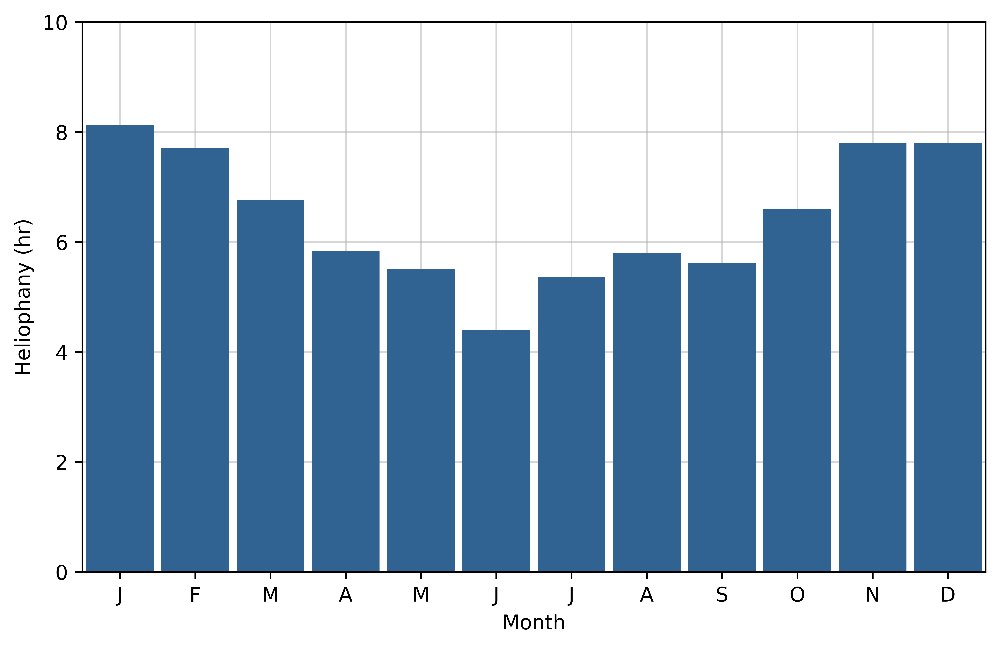

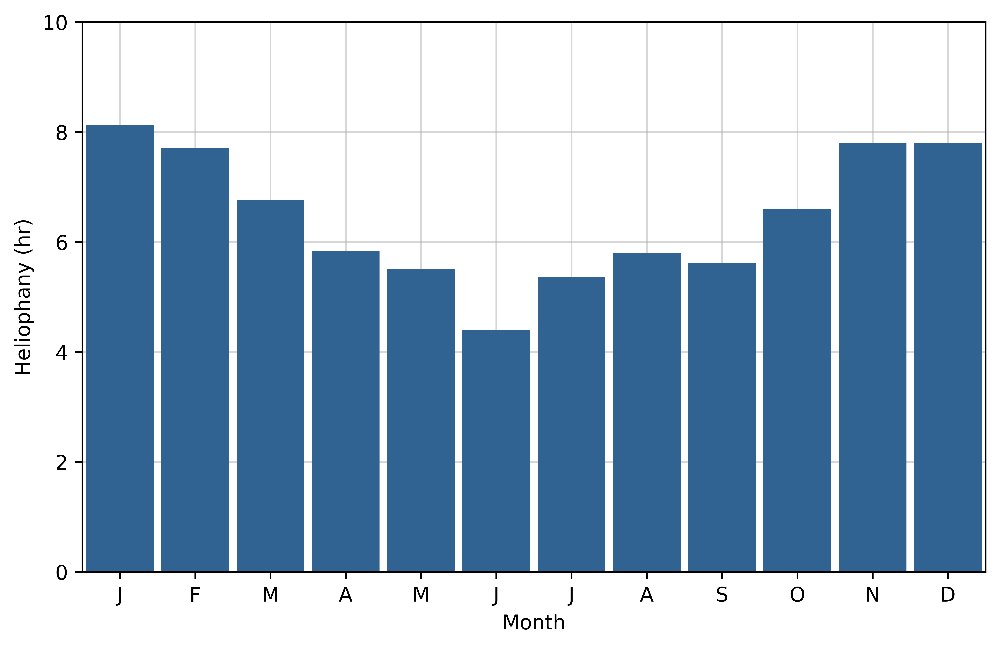

In [11]:
########### 2. CLIMATOLOGIA MEDIA REGIONAL ##########

#media regional
medias_mensuales_smn_media_regional = pd.concat(medias_mensuales_smn, axis = 1).mean(axis=1, skipna=True)

#medias climatologicas
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
medias_mensuales_smn_media_regional.index = pd.to_datetime(medias_mensuales_smn_media_regional.index)
medias_mensuales_smn_media_regional_fechas_climatologia = medias_mensuales_smn_media_regional.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
medias_mensuales_smn_media_regional_climatologia = medias_mensuales_smn_media_regional_fechas_climatologia.groupby(medias_mensuales_smn_media_regional_fechas_climatologia.index.month).mean() 

#las grafico
def plot_climatologia_regional():
    fig2 = plt.figure(num=1, figsize=(8, 5), dpi=1000) #genero figura
    ax = fig2.add_subplot(111) # Create matplotlib axes
    meses = ['J', 'F', 'M', 'A', 'M', "J", "J", "A", "S", "O","N", "D"] #inicial meses
    width = 0.9 #ancho de las barras
    medias_mensuales_smn_media_regional_climatologia.plot(kind='bar', color="#306292", ax=ax, width=width, zorder = 2)
    ax.set_ylabel('Heliophany (hr)')
    ax.set_ylim(0, 10)
    plt.xlabel("Month")
    ax.set_xlim(-0.5, 11.5)
    ax.set_xticklabels(meses,rotation = 0)
    ax.grid(alpha = 0.5, zorder = 1)
    return(fig2)

plot_climatologia_regional()

In [12]:
########### 3. MAPA CON MEDIAS ANUALES ##########

# Calculo media anual en periodo climatológico de SMN
climatologia_anual_medias_mensuales_smn = {} 
for id_omm in ides_omm_ordenado:
    #calculo climatologia
    media_mensual_df = medias_mensuales_smn[id_omm]
    media_mensual_df.index = pd.to_datetime(media_mensual_df.index)
    media_mensual_fechas_climatologia = media_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    media_mensual_climatologia_anual = media_mensual_fechas_climatologia.mean() 
    #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn
    climatologia_anual_medias_mensuales_smn[id_omm] = media_mensual_climatologia_anual

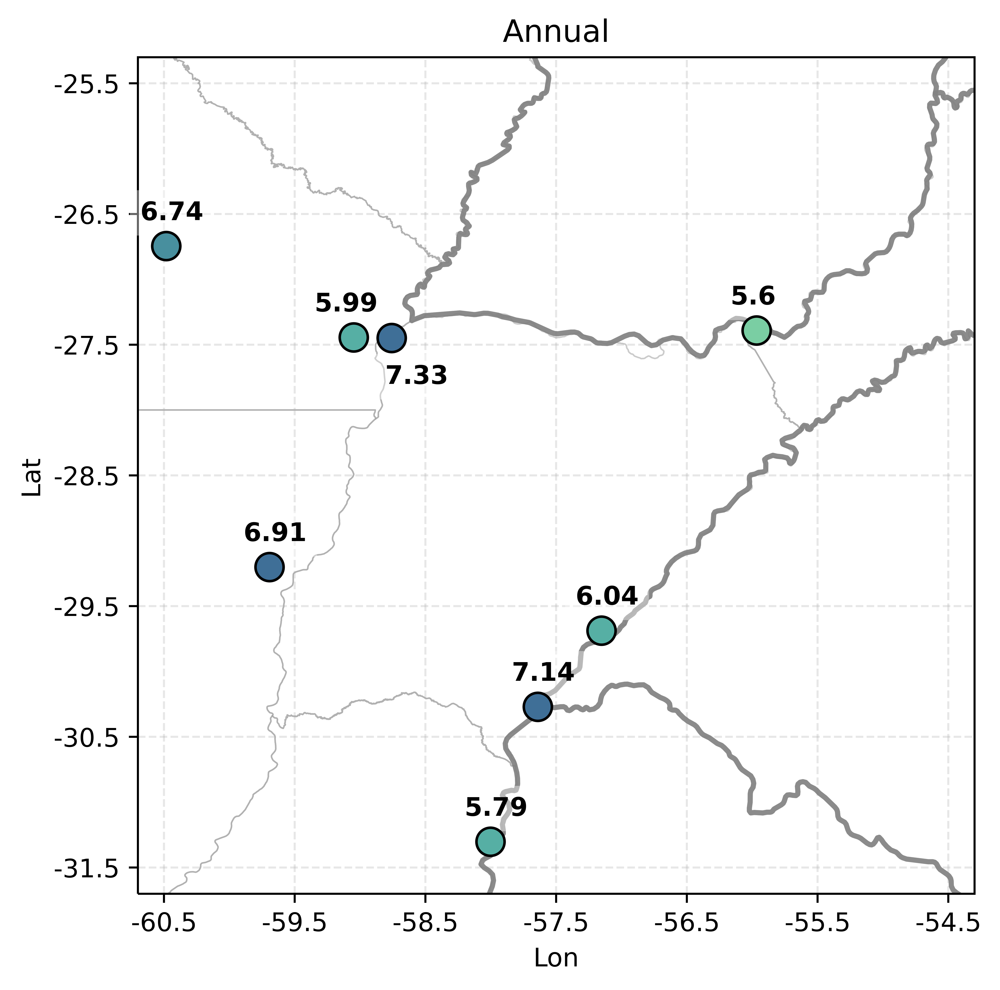

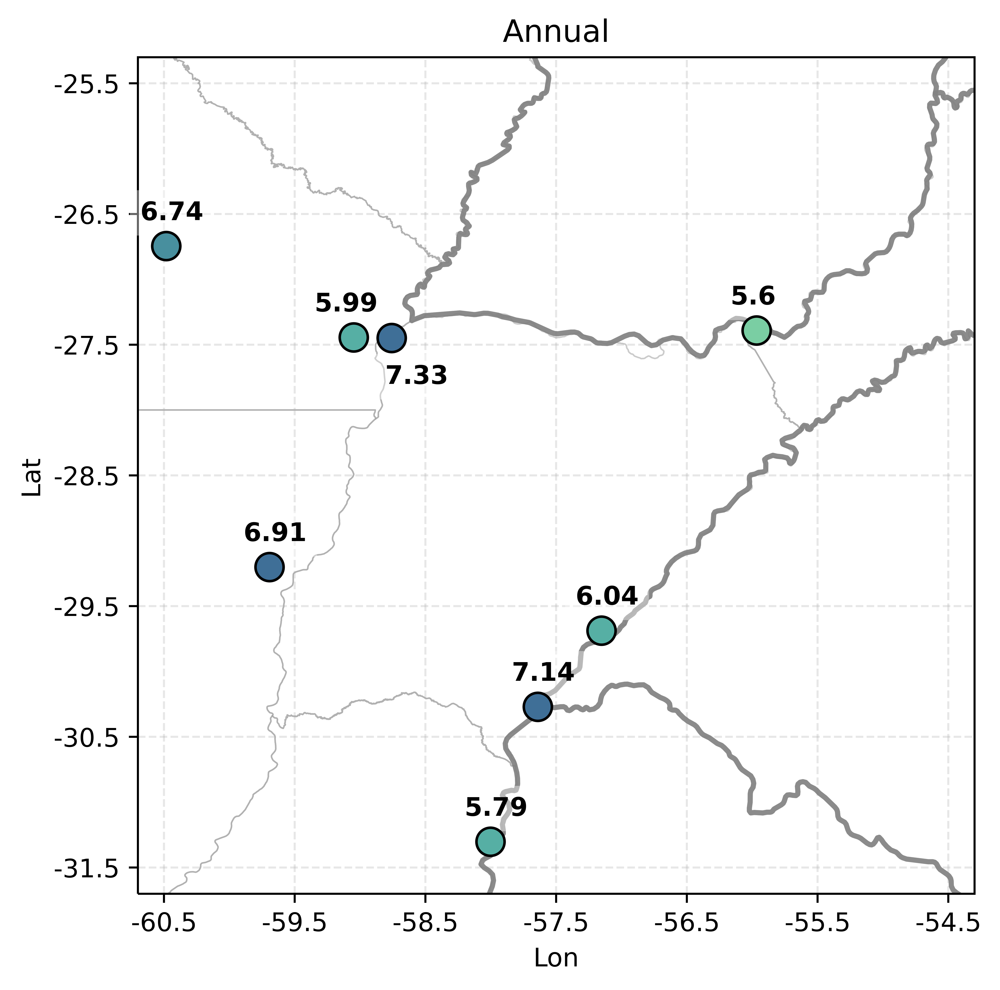

In [13]:
#Grafico
from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

#puntos que uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,8)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)

def plot_mapa_media_anual():
    valor_minimo = 4
    valor_maximo = 9
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    medias_anuales_estaciones_ordenadas = [climatologia_anual_medias_mensuales_smn[i].values[0] for i in ides_omm_ordenado]

    #defino puntos a marcar
    geometry_3 = [Point(xy) for xy in lista_puntos_smn_ordenados] #lista con puntos 2
    geodata3 = gpd.GeoDataFrame(lista_puntos_smn_ordenados, geometry = geometry_3)
    geodata3["valores"] = medias_anuales_estaciones_ordenadas

    fig3 = plt.figure(figsize = [9.6, 6], dpi = 900)    
    ax = fig3.add_subplot(111, projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

    #agrego geometrias de fondo: provincias y paises
    ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
    ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

    ##esto para discretizar la paleta:
    mi_cmap = cmocean.cm.deep # define the colormap  rain
    mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)] # extract all colors from the .rain map
    mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
        'Custom cmap', mi_cmaplist, mi_cmap.N) # create the new map
    bounds = np.linspace(valor_minimo, valor_maximo, 10) # define the bins and normalize
    norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)

    #ploteo valores
    geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, edgecolor = "k") #limites de 0 a 8

    #agrego etiquetas con valores
    list_smn_etiquetas = [(lon-0.2-360, lat+0.25) for lon, lat in lista_puntos_smn_ordenados]
    for i, clave in enumerate(medias_anuales_estaciones_ordenadas):
        if list(estaciones_ordenadas.values())[i] != "Corrientes" and list(estaciones_ordenadas.values())[i] != "Resistencia":
            t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        elif list(estaciones_ordenadas.values())[i] == "Corrientes":
            t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[i][0]+0.15,list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
        else:
            t = ax.annotate(str(round(clave,2)),(list_smn_etiquetas[i][0]-0.1,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
        t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

    #agrego titulo a colorbar
    #trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
    #ann = ax.annotate('Okta', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    ax.set_xticklabels(np.arange(xticks_min, xticks_max+1))
    plt.xticks(np.arange(xticks_min, xticks_max+1))
    ax.set_xlabel("Lon")
    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    ax.set_yticklabels(np.arange(yticks_min, yticks_max+1))
    plt.yticks(np.arange(yticks_min, yticks_max+1))
    ax.set_ylabel("Lat")

    plt.title("Annual")
    plt.grid(linestyle="--", alpha=0.3)
    return(fig3)

plot_mapa_media_anual()

In [14]:
########### 3. MAPA CON MEDIAS ESTACIONALES ##########

# Calculo medias estacionales en periodo climatológico de SMN
climatologia_estacion_medias_mensuales_smn = {} 
#para cada id_omm_ordenado
for id_omm in ides_omm_ordenado:
    #calculo climatologia
    media_mensual_df = medias_mensuales_smn[id_omm]
    media_mensual_df.index = pd.to_datetime(media_mensual_df.index)
    media_mensual_fechas_climatologia = media_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    media_mensual_climatologia_DJF = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 12) | (media_mensual_fechas_climatologia.index.month == 1) | (media_mensual_fechas_climatologia.index.month == 2)]).mean()
    media_mensual_climatologia_MAM = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 3) | (media_mensual_fechas_climatologia.index.month == 4) | (media_mensual_fechas_climatologia.index.month == 5)]).mean()
    media_mensual_climatologia_JJA = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 6) | (media_mensual_fechas_climatologia.index.month == 7) | (media_mensual_fechas_climatologia.index.month == 8)]).mean()
    media_mensual_climatologia_SON = (media_mensual_fechas_climatologia[(media_mensual_fechas_climatologia.index.month == 9) | (media_mensual_fechas_climatologia.index.month == 10) | (media_mensual_fechas_climatologia.index.month == 11)]).mean()
    media_mensual_climatologia_estacional = {"DJF": media_mensual_climatologia_DJF, "MAM":media_mensual_climatologia_MAM, "JJA":media_mensual_climatologia_JJA, "SON":media_mensual_climatologia_SON}
    climatologia_estacion_medias_mensuales_smn[id_omm] = media_mensual_climatologia_estacional


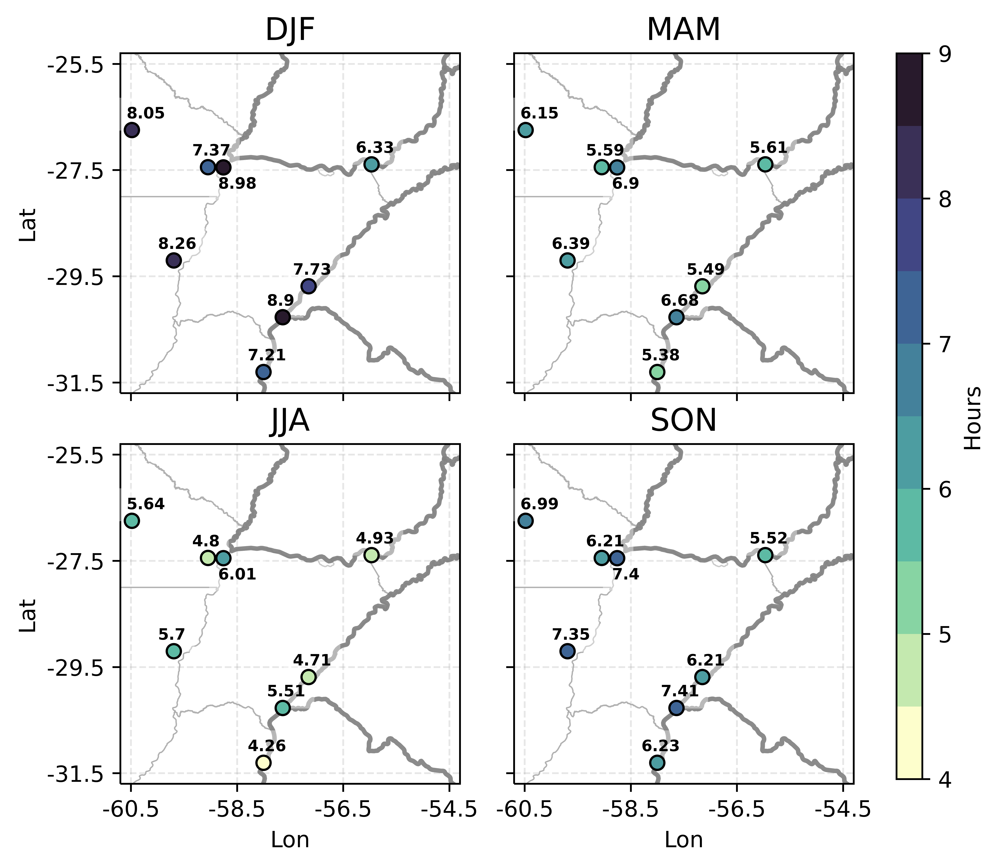

In [15]:
#Grafico medias estacionales

estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]
medias_DJF_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["DJF"].values[0] for i in ides_omm_ordenado]
medias_MAM_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["MAM"].values[0] for i in ides_omm_ordenado]
medias_JJA_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["JJA"].values[0] for i in ides_omm_ordenado]
medias_SON_estaciones_ordenadas = [climatologia_estacion_medias_mensuales_smn[i]["SON"].values[0] for i in ides_omm_ordenado]
medias_estaciones_ordenadas_list = [medias_DJF_estaciones_ordenadas,medias_MAM_estaciones_ordenadas,medias_JJA_estaciones_ordenadas,medias_SON_estaciones_ordenadas]

def plot_mapa_medias_estacionales():
    valor_minimo = 4
    valor_maximo = 9
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    fig3b = plt.figure(figsize = [8, 6], dpi = 900) 

    for i in range(0,4):
        ax = fig3b.add_subplot(posicion[i], projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

        #agrego geometrias de fondo: provincias y paises
        ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
        ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

        #defino puntos a marcar
        geometry_3 = [Point(xy) for xy in lista_puntos_smn_ordenados] #lista con puntos 2
        geodata3 = gpd.GeoDataFrame(lista_puntos_smn_ordenados, geometry = geometry_3)
        geodata3["valores"] = medias_estaciones_ordenadas_list[i]

        mi_cmap = cmocean.cm.deep # define the colormap  rain
        mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)] # extract all colors from the .rain map
        mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
            'Custom cmap', mi_cmaplist, mi_cmap.N) # create the new map
        bounds = np.linspace(valor_minimo, valor_maximo, 11) # define the bins and normalize
        norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
        ##fin de discretizado de paleta

        geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                      markersize = 40, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, edgecolor = "k") #limites de 0 a 8

        #agrego etiquetas con valores
        list_smn_etiquetas = [(lon-0.3-360, lat+0.30) for lon, lat in lista_puntos_smn_ordenados]
        for j, clave in enumerate(medias_estaciones_ordenadas_list[i]):
            if list(estaciones_ordenadas.values())[j] != "Resistencia" and list(estaciones_ordenadas.values())[j] != "Corrientes" and list(estaciones_ordenadas.values())[j] != "Roque Saenz Peña":
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0],list_smn_etiquetas[j][1]-0.08), size = 7,weight='bold', zorder = 3)
            elif list(estaciones_ordenadas.values())[j] == "Corrientes":
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0]+0.2,list_smn_etiquetas[j][1]-0.7), size = 7,weight='bold', zorder = 3)
            elif list(estaciones_ordenadas.values())[j] == "Roque Saenz Peña":
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0]+0.2,list_smn_etiquetas[j][1]-0.08), size = 7,weight='bold', zorder = 3)
            else:
                t = ax.annotate(str(round(clave,2)), (list_smn_etiquetas[j][0],list_smn_etiquetas[j][1]-0.08) , size = 7,weight='bold', zorder = 3)
            t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

        #agrego titulo a colorbar
        #trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
        #ann = ax.annotate('Okta', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

        #seteo ejes
        #x
        ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
        plt.xticks(np.arange(xticks_min, xticks_max+1, 2))
        if i == 0 or i == 1: #saco levels de x para los dos graficos de arriba
            ax.set_xticklabels([])
        else:
            ax.set_xticklabels(np.arange(xticks_min, xticks_max+1, 2))
            ax.set_xlabel("Lon")
        #y 
        ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
        plt.yticks(np.arange(yticks_min, yticks_max+1, 2))
        if i == 1 or i == 3: #saco levels de x para los dos graficos de la derecha
            ax.set_yticklabels([])
        else:
            ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, 2))
            ax.set_ylabel("Lat")
        ax.grid(linestyle="--", alpha=0.3)
        ax.set_title(estaciones[i], size= 14)

    #fig3b.subplots_adjust(right=0.8)
    fig3b.subplots_adjust(wspace=-0.35,hspace=0.15)
    cbar_ax = fig3b.add_axes([0.83, 0.13, 0.02, 0.75])

    sm = plt.cm.ScalarMappable(cmap=mi_cmap2, norm=norm)
    # fake up the array of the scalar mappable. Urgh...
    sm._A = []
    fig3b.colorbar(sm, cax=cbar_ax,label = "Hours")

plot_mapa_medias_estacionales()

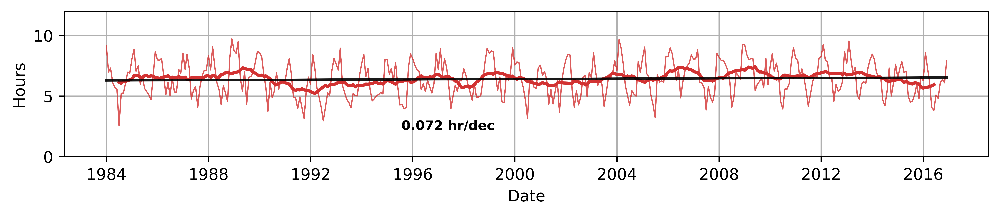

In [16]:
############# 4. SERIE TEMPORAL DE HELIOFANIA CON TENDENCIA ###############
#defino funcion que calcula tendencia_theil_sen
import pymannkendall as mk
import scipy

def tendencia_theil_sen(serie):
    valores = serie.values[np.isfinite(serie.values)]
    #fechas = np.arange(0, len(serie), 1)[np.isfinite(serie.values)]
    fechas = np.arange(0, len(valores), 1)
        
    # si el vector es todo de nan entonces que no calcule la tendencia, y que devuelva nan
    if valores.size <= 1:
        tendencia = np.nan
        significativo = np.nan
        
    # si el vector tiene valores distintos de nan calcula tendencia y significancia con 95%
    elif valores.size > 1:
        coef = scipy.stats.mstats.theilslopes(y=valores, x=fechas, alpha=0.95)
        tendencia = coef[0]  # dada entre un intervalo de tiempo. A esta salida si quiero tendencia decadal e ingrese datos de toda la serie mensual lo multiplico por 10*12 y si quiero por decada y vienen dados por un dato anual se multiplica por 10
        coord_origen = coef[1]
        
        ##Hago el test con el z estadistico para alpha = 0.95
        #z_test = mk.original_test(valores, alpha = 0.05)[3]
        #if abs(z_test) >= 1.96:
         #   significativo_95 = True
        #elif abs(z_test) < 1.96:
         #   significativo_95 = False
        
        ##Hago el test con el p-value para y determino si es significativo con alpha = 0.95 o alpha=0.90
        pvalue_test = mk.original_test(valores)[2]
        if pvalue_test <= 0.01:
            significativo_99 = True
            significativo_95 = True
            significativo_90 = True
        elif pvalue_test <= 0.05:
            significativo_99 = False
            significativo_95 = True
            significativo_90 = True
        elif pvalue_test <= 0.1:
            significativo_99 = False
            significativo_95 = False
            significativo_90 = True
        else:
            significativo_99 = False
            significativo_95 = False
            significativo_90 = False        
    return(coord_origen, tendencia, significativo_99, significativo_95, significativo_90, pvalue_test)

#grafico serie con media movil
#calculo media mobil de 12 meses
from f_promedio_movil import f_promedio_movil

def plot_serie_tendencia_media_movil(fecha_inicio, fecha_final):
    #data
    medias_mensuales_smn_media_regional_data = medias_mensuales_smn_media_regional.loc[fecha_inicio:fecha_final]
    ventana = 12
    medias_mensuales_smn_media_regional_media_movil_data = f_promedio_movil(medias_mensuales_smn_media_regional_data, ventana)
    
    fig4b = plt.figure(num=1, figsize=(9, 2), dpi=900)
    
    plt.subplot(1, 1, 1)
    plt.plot(medias_mensuales_smn_media_regional_data, color = "#D23232", linewidth = 0.8, alpha = 0.8)
    plt.plot(medias_mensuales_smn_media_regional_data.index, medias_mensuales_smn_media_regional_media_movil_data, color = "#D23232", linewidth = 2, alpha = 1)

    plt.ylim((0,12))
    plt.ylabel("Hours")
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.grid()
    plt.tight_layout()
    #tendencia theil sen
    tendencia_smn_sen = tendencia_theil_sen(medias_mensuales_smn_media_regional_data)
    pendiente_smn_sen = tendencia_smn_sen[1]
    origen_smn_sen = tendencia_smn_sen[0]
    significativo_smn_sen_99 = tendencia_smn_sen[2]
    significativo_smn_sen_95 = tendencia_smn_sen[3]
    significativo_smn_sen_90 = tendencia_smn_sen[4]
    grafico_tendencia_smn_sen = origen_smn_sen + pendiente_smn_sen * np.arange(0, len(medias_mensuales_smn_media_regional_data.index), 1)
    if significativo_smn_sen_99 == True:
        plt.text(10000, 2.5, f"{round(pendiente_smn_sen*10*12, 3)} hr/dec ***",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == True:
        plt.text(10000, 2.5, f"{round(pendiente_smn_sen*10*12, 3)} hr/dec **",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    elif significativo_smn_sen_99 == False and significativo_smn_sen_95 == False and significativo_smn_sen_90 == True:
        plt.text(10000, 2.5, f"{round(pendiente_smn_sen*10*12, 3)} hr/dec *",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    else:
        plt.text(10000, 2.5, f"{round(pendiente_smn_sen*10*12, 3)} hr/dec",color="k", 
                         ha="center", va = "center", fontsize =  'small',
                         weight='bold') #horizontalalignment='center', verticalalignment='center'
    plt.plot(medias_mensuales_smn_media_regional_data.index, 
                 grafico_tendencia_smn_sen,color = "k", alpha = 0.9)
    #return(fig4b)

#intervalo temporal 1
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
plot_serie_tendencia_media_movil(fecha_inicio_climatologia_str, fecha_final_climatologia_str)
#plt.close()

#intervalo temporal 2 March 1961 to February 2021
fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"
#plot_serie_tendencia_media_movil(fecha_inicio_str, fecha_final_str)

In [17]:
############### 5. CALCULO DE TENDENCIAS DE THEIL-SEN POR ESTACION PARA LA MEDIA REGIONAL #############

#calculo serie de medias estacionales de la media regional
#smn
#absoluto
#hago medias estacionales y luego hago la media regional de esas series
def calculo_medias_estaciones_smn(serie, estacion = "DJF"):
    serie_fechas = pd.to_datetime(serie.index)
    medias_estacion_list =  [] #donde se van acomodando los datos
    for anio in serie_fechas.year.unique():#iterar sobre los anios
        data_anio = serie[serie.index.year == anio]
        #data_anio = xrdata.sel[dict(time = xrdata.time[serie_fechas.year == anio])]
        if estacion == "DJF":
            try:
                data_anio_previo = serie[serie.index.year == anio-1]
                Dec = data_anio_previo[data_anio_previo.index.month == 12]
                Jan = data_anio[data_anio.index.month == 1]
                Feb = data_anio[data_anio.index.month == 2]
                data_estacion = pd.concat([Dec, Jan, Feb])             
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan
        elif estacion == "MAM":
            try:
                Mar = data_anio[data_anio.index.month ==  3]
                Abr = data_anio[data_anio.index.month ==  4]
                May = data_anio[data_anio.index.month ==  5]
                data_estacion = pd.concat([Mar,Abr,May])                
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan          
        elif estacion == "JJA":
            try:
                Jun = data_anio[data_anio.index.month == 6]
                Jul = data_anio[data_anio.index.month == 7]
                Ag = data_anio[data_anio.index.month == 8]
                data_estacion = pd.concat([Jun, Jul, Ag])                  
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)        
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan   
        elif estacion == "SON":
            try:
                Sep = data_anio[data_anio.index.month == 9]
                Oct = data_anio[data_anio.index.month == 10]
                Nov = data_anio[data_anio.index.month == 11]
                data_estacion = pd.concat([Sep,Oct,Nov])                  
                data_media_estacion = data_estacion.mean(axis=0, skipna=True)
                #data_media_estacion.attrs['time'] = anio
                medias_estacion_list.append(data_media_estacion)
            except IndexError as e:
                print(f"No estan los datos para {anio} para {estacion}, devuelve este error:{e}")
                data_media_estacion = np.nan        
    #xr_medias_estacion = xr.concat(xr_medias_estacion_list, dim = "time")
    medias_estacion_df = pd.DataFrame(medias_estacion_list)
    medias_estacion_df.index = serie_fechas.year.unique()
    return medias_estacion_df
#medias_mensuales_smn_media_regional[medias_mensuales_smn_media_regional.index.month==12]

################ periodo 1983-2016 ################
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"

#media estacional
series_medias_estacionales_DJF_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "DJF") for i in ides_omm_ordenado]
series_medias_estacionales_MAM_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "MAM") for i in ides_omm_ordenado]
series_medias_estacionales_JJA_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "JJA") for i in ides_omm_ordenado]
series_medias_estacionales_SON_estaciones_ordenadas = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_climatologia_str: fecha_final_climatologia_str], estacion = "SON") for i in ides_omm_ordenado]
series_medias_estacionales_estaciones_ordenadas_list = [series_medias_estacionales_DJF_estaciones_ordenadas,
                                                        series_medias_estacionales_MAM_estaciones_ordenadas,
                                                        series_medias_estacionales_JJA_estaciones_ordenadas,
                                                        series_medias_estacionales_SON_estaciones_ordenadas]
#media regional
smn_series_medias_estacionales_media_regional_DJF = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[0], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_MAM = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[1], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_JJA = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[2], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_SON = pd.concat(series_medias_estacionales_estaciones_ordenadas_list[3], axis = 1).mean(axis = 1, skipna = True)

#calculo la tendencia de theil-sen
smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_DJF)
smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_MAM)
smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_JJA)
smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_SON)

tabla_tendencias_1983_2016 =  pd.DataFrame({"DJF": [smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_DJF_tendencia_1983_2016[5]],
                                              "MAM": [smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_MAM_tendencia_1983_2016[5]],
                                              "JJA": [smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_JJA_tendencia_1983_2016[5]],
                                              "SON": [smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016[1],smn_series_medias_estacionales_media_regional_SON_tendencia_1983_2016[5]]}).transpose()
tabla_tendencias_1983_2016.columns = ["1983_2016_tendencia","1983_2016_p_valor"]
tabla_tendencias_1983_2016["1983_2016_tendencia"] = tabla_tendencias_1983_2016["1983_2016_tendencia"]*10
tabla_tendencias_1983_2016.columns = ["1983_2016_tendencia hr/dec","1983_2016_p_valor"]

#hago lo mismo que antes pero para el periodo 1961-2020
#uso datos de marzo 1961 a febrero 2021 para tener estaciones completas 

fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"

series_medias_estacionales_DJF_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "DJF") for i in ides_omm_ordenado]
series_medias_estacionales_MAM_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "MAM") for i in ides_omm_ordenado]
series_medias_estacionales_JJA_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "JJA") for i in ides_omm_ordenado]
series_medias_estacionales_SON_estaciones_ordenadas_2 = [calculo_medias_estaciones_smn(medias_mensuales_smn[i][fecha_inicio_str: fecha_final_str], estacion = "SON") for i in ides_omm_ordenado]
series_medias_estacionales_estaciones_ordenadas_list_2 = [series_medias_estacionales_DJF_estaciones_ordenadas_2,
                                                        series_medias_estacionales_MAM_estaciones_ordenadas_2,
                                                        series_medias_estacionales_JJA_estaciones_ordenadas_2,
                                                        series_medias_estacionales_SON_estaciones_ordenadas_2]

smn_series_medias_estacionales_media_regional_DJF_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[0], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_MAM_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[1], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_JJA_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[2], axis = 1).mean(axis = 1, skipna = True)
smn_series_medias_estacionales_media_regional_SON_2 = pd.concat(series_medias_estacionales_estaciones_ordenadas_list_2[3], axis = 1).mean(axis = 1, skipna = True)

#calculo la tendencia de theil-sen
smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_DJF_2)
smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_MAM_2)
smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_JJA_2)
smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021 = tendencia_theil_sen(smn_series_medias_estacionales_media_regional_SON_2)

tabla_tendencias_1961_2021 =  pd.DataFrame({"DJF": [smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_DJF_tendencia_1961_2021[5]],
                                              "MAM": [smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_MAM_tendencia_1961_2021[5]],
                                              "JJA": [smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_JJA_tendencia_1961_2021[5]],
                                              "SON": [smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021[1],smn_series_medias_estacionales_media_regional_SON_tendencia_1961_2021[5]]}).transpose()
tabla_tendencias_1961_2021.columns = ["1961_2021_tendencia","1961_2021_p_valor"]
tabla_tendencias_1961_2021["1961_2021_tendencia"] = tabla_tendencias_1961_2021["1961_2021_tendencia"]*10
tabla_tendencias_1961_2021.columns = ["1961_2021_tendencia hr/dec","1961_2021_p_valor"]

tabla_tendencias = pd.concat([tabla_tendencias_1983_2016, tabla_tendencias_1961_2021], axis = 1)
tabla_tendencias

,1983_2016_tendencia hr/dec,1983_2016_p_valor,1961_2021_tendencia hr/dec,1961_2021_p_valor
DJF,0.070021,0.566446,-0.059843,0.275438
MAM,0.190482,0.177654,-0.061805,0.248334
JJA,0.199057,0.039326,0.014296,0.735340
SON,0.126953,0.344578,-0.091233,0.054889


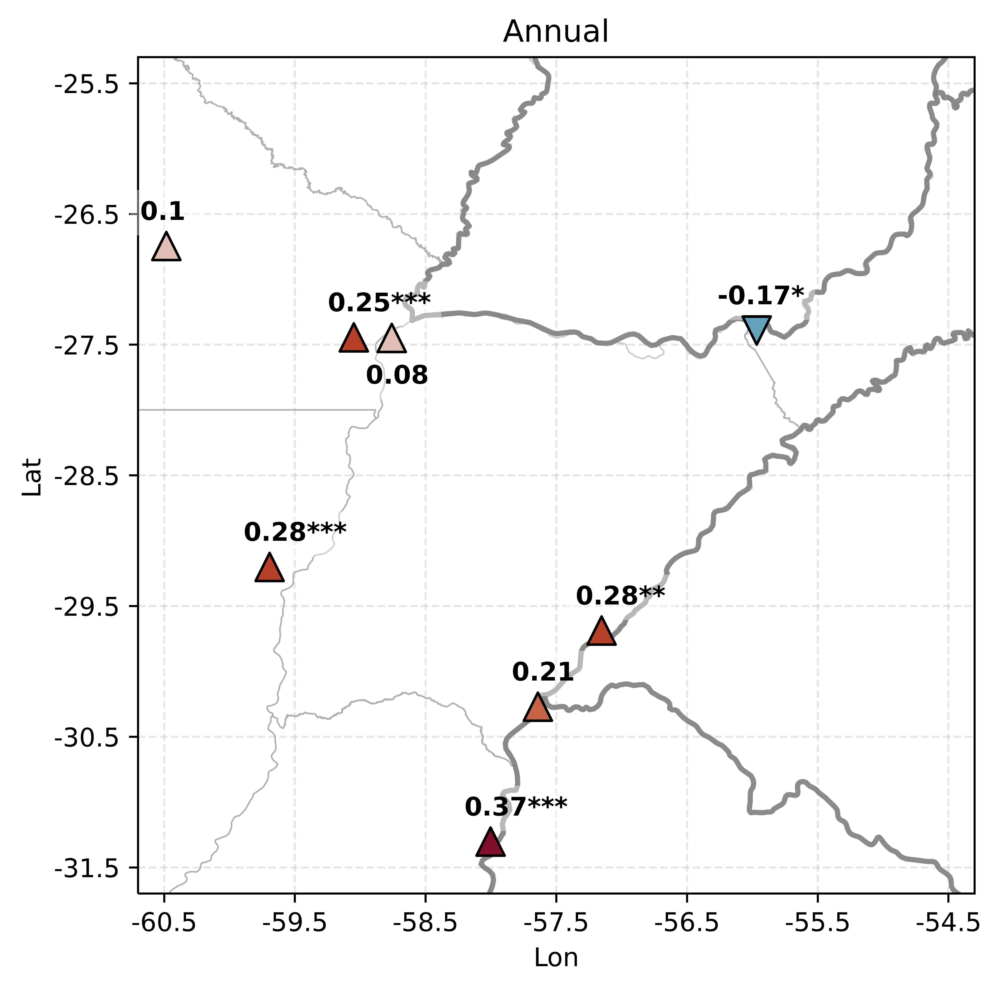

In [18]:
############ 6. MAPA CON TENDENCIAS ANUAL PERIODO CLIMATOLOGICO ##############
from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"

# Calculo tendencia anual de heliofania en periodo climatológico de SMN
tendencia_anual_smn = {} 
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    #calculo climatologia 
    mensual_df = medias_mensuales_smn[id_omm]
    mensual_df.index = pd.to_datetime(medias_mensuales_smn[id_omm].index)
    mensual_fechas_climatologia = mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    mensual_tendencia_anual_theil_sen = tendencia_theil_sen(mensual_fechas_climatologia)
    tendencia_anual_smn[id_omm] = mensual_tendencia_anual_theil_sen #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn

#puntos que uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,8)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)

#hago lista con valores de tendencia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
#distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
lista_puntos_smn_mayor_a_cero = []
lista_puntos_smn_menor_a_cero = []
lista_puntos_smn_igual_a_cero = []
for i in range(len(lista_puntos_smn_ordenados)):
    if tendencias_anuales_estaciones_ordenadas[i] < 0:  #tendencias_anuales_estaciones_ordenadas[i] < 0
        lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[i])
    elif tendencias_anuales_estaciones_ordenadas[i] > 0:
        lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[i])
    else:
        lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[i])
valores_menor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor<0]
valores_mayor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor>0]
valores_igual_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor==0]

#hago lista con simbolos de significancia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
lista_significancia = []
for est in estaciones_ordenadas.keys():
    if tendencia_anual_smn[est][2] == True:
        lista_significancia.append("***")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == True:
        lista_significancia.append("**")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == False and tendencia_anual_smn[est][4] == True:
        lista_significancia.append("*")
    else:
        lista_significancia.append(" ")

#grafico
def plot_mapa_tendencias():
    valor_minimo = -0.5
    valor_maximo = 0.5
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in ides_omm_ordenado]

    #defino puntos a marcar (distingo entre tendencias positivas, negativas o nulas)
    geometry_1 = [Point(xy) for xy in lista_puntos_smn_igual_a_cero] #lista con puntos 2
    geodata1 = gpd.GeoDataFrame(lista_puntos_smn_igual_a_cero, geometry = geometry_1)
    geodata1["valores"] = valores_igual_a_cero

    geometry_2 = [Point(xy) for xy in lista_puntos_smn_mayor_a_cero] #lista con puntos 2
    geodata2 = gpd.GeoDataFrame(lista_puntos_smn_mayor_a_cero, geometry = geometry_2)
    geodata2["valores"] = valores_mayor_a_cero

    geometry_3 = [Point(xy) for xy in lista_puntos_smn_menor_a_cero] #lista con puntos 2
    geodata3 = gpd.GeoDataFrame(lista_puntos_smn_menor_a_cero, geometry = geometry_3)
    geodata3["valores"] = valores_menor_a_cero

    fig1 = plt.figure(figsize =  [9.6, 6], dpi = 1000)    #dpi = 600
    ax = fig1.add_subplot(111, projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

    #agrego geometrias de fondo: provincias y paises
    ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
    ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

    ###esto para discretizar la paleta:
    ##
    mi_cmap = cmocean.cm.balance # define the colormap  diff al reves
    ## extract all colors from the .rain map
    mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
    ## create the new map
    mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
        'Custom cmap', mi_cmaplist, mi_cmap.N)
    ## define the bins and normalize
    bounds = np.linspace(valor_minimo, valor_maximo, 21)
    norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
    ##fin de discretizado de paleta

    #grafico puntos
    geodata1.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker='o') #limites de 0 a 8

    geodata2.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker='^') #limites de 0 a 8

    geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                  markersize = 120, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                  edgecolor = "k", marker = "v") #limites de 0 a 8

    #agrego etiquetas con valores
    list_smn_etiquetas = [(lon-0.2-360, lat+0.25) for lon, lat in lista_puntos_smn_ordenados]
    for i, clave in enumerate(tendencias_anuales_estaciones_ordenadas):
        if list(estaciones_ordenadas.values())[i] != "Posadas" and list(estaciones_ordenadas.values())[i] != "Corrientes" and list(estaciones_ordenadas.values())[i] != "Resistencia":
            if round(clave,2) == 0:
                t = ax.annotate(f"{0}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)

        elif list(estaciones_ordenadas.values())[i] == "Corrientes":
            if round(clave,2) == 0:
                t = ax.annotate(f"{round(0)}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.6) , size = 10,weight='bold', zorder = 3)

        elif list(estaciones_ordenadas.values())[i] == "Posadas":
            if round(clave,2) == 0:
                t = ax.annotate(f"{0}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0]-0.1,list_smn_etiquetas[i][1]-0.05), size = 10,weight='bold', zorder = 3)

        else:
            if round(clave,2) == 0:
                t = ax.annotate(f"{0}{lista_significancia[i]}", (list_smn_etiquetas[i][0]+0.13,list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)
            else:
                t = ax.annotate(f"{round(clave,2)}{lista_significancia[i]}", (list_smn_etiquetas[i][0],list_smn_etiquetas[i][1]-0.05) , size = 10,weight='bold', zorder = 3)

        t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

    ##agrego titulo a colorbar
    #trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
    #ann = ax.annotate('%/dec', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

    #seteo ejes
    ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
    ax.set_xticklabels(np.arange(xticks_min, xticks_max+1))
    plt.xticks(np.arange(xticks_min, xticks_max+1))
    ax.set_xlabel("Lon")
    ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
    ax.set_yticklabels(np.arange(yticks_min, yticks_max+1))
    plt.yticks(np.arange(yticks_min, yticks_max+1))
    ax.set_ylabel("Lat")
    plt.title("Annual")

    plt.grid(linestyle="--", alpha=0.3)

plot_mapa_tendencias() #periodo clim

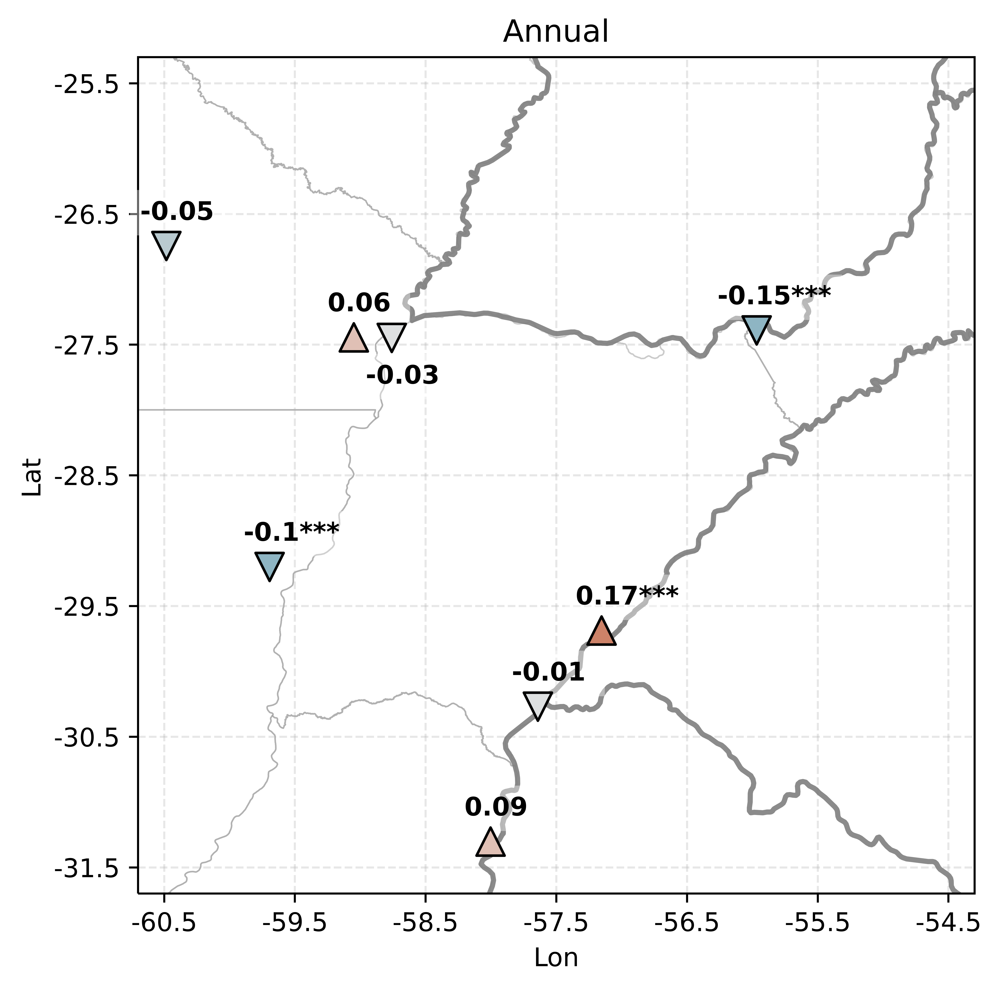

In [19]:
############ 6. MAPA CON TENDENCIAS ANUAL PERIODO A LARGO PLAZO ##############
from f_mis_shapes import df_paises, df_provincias
import geopandas as gpd
from shapely.geometry import Point
import cartopy.crs as ccrs
import cmocean 
import matplotlib as mpl

fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"

# Calculo tendencia anual de heliofania en periodo climatológico de SMN
tendencia_anual_smn = {} 
for id_omm in ides_omm_ordenado: #para cada id_omm_ordenado
    #calculo climatologia 
    mensual_df = medias_mensuales_smn[id_omm]
    mensual_df.index = pd.to_datetime(medias_mensuales_smn[id_omm].index)
    mensual_fechas_climatologia = mensual_df.loc[fecha_inicio_str:fecha_final_str]
    mensual_tendencia_anual_theil_sen = tendencia_theil_sen(mensual_fechas_climatologia)
    tendencia_anual_smn[id_omm] = mensual_tendencia_anual_theil_sen #Lo guardo en diccionario: climatologia_anual_medias_mensuales_smn

#puntos que uso
lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,8)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)

#hago lista con valores de tendencia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
#distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
lista_puntos_smn_mayor_a_cero = []
lista_puntos_smn_menor_a_cero = []
lista_puntos_smn_igual_a_cero = []
for i in range(len(lista_puntos_smn_ordenados)):
    if tendencias_anuales_estaciones_ordenadas[i] < 0:  #tendencias_anuales_estaciones_ordenadas[i] < 0
        lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[i])
    elif tendencias_anuales_estaciones_ordenadas[i] > 0:
        lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[i])
    else:
        lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[i])
valores_menor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor<0]
valores_mayor_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor>0]
valores_igual_a_cero = [valor for valor in tendencias_anuales_estaciones_ordenadas if valor==0]

#hago lista con simbolos de significancia
tendencias_anuales_estaciones_ordenadas = [tendencia_anual_smn[i][1]*10*12 for i in estaciones_ordenadas.keys()]
lista_significancia = []
for est in estaciones_ordenadas.keys():
    if tendencia_anual_smn[est][2] == True:
        lista_significancia.append("***")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == True:
        lista_significancia.append("**")
    elif tendencia_anual_smn[est][2] == False and tendencia_anual_smn[est][3] == False and tendencia_anual_smn[est][4] == True:
        lista_significancia.append("*")
    else:
        lista_significancia.append(" ")

plot_mapa_tendencias()

In [1]:
############ 6. MAPA CON TENDENCIAS ESTACIONALES PERIODO CLIMATOLOGICO ##############
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"

estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]

lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,8)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)
lista_puntos_smn_ordenados
list(estaciones_ordenadas.values())[0]    

tendencias_DJF_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[0][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[1][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[2][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[3][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list = [tendencias_DJF_estaciones_ordenadas,
                                           tendencias_MAM_estaciones_ordenadas,
                                           tendencias_JJA_estaciones_ordenadas,
                                           tendencias_SON_estaciones_ordenadas]

#significancias
tendencias_DJF_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[0][i]) for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[1][i]) for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[2][i]) for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list[3][i]) for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list_significancias = [tendencias_DJF_estaciones_ordenadas_significancias,
                                           tendencias_MAM_estaciones_ordenadas_significancias,
                                           tendencias_JJA_estaciones_ordenadas_significancias,
                                           tendencias_SON_estaciones_ordenadas_significancias]

def plot_mapa_tendencias_estaciones():
    valor_minimo = -0.5
    valor_maximo = 0.5
    xticks_min = -60.5
    xticks_max = -54.5
    yticks_min = -31.5
    yticks_max = -25.5
    espacio_entre_lat_lon = 1
    #fig1, ax = plt.subplots(2, 2, figsize=[9, 7], dpi=600)
    fig1 = plt.figure(figsize = [8, 6], dpi = 900) 

    for i in range(0,4):    
        ###########
        #distingo entre mayor a cero, menor e igual a cero porque van a tener distinto simbolo
        lista_puntos_smn_mayor_a_cero = []
        lista_puntos_smn_menor_a_cero = []
        lista_puntos_smn_igual_a_cero = []
        for j in range(len(lista_puntos_smn_ordenados)):
            if tendencias_estaciones_ordenadas_list[i][j] < 0:
                lista_puntos_smn_menor_a_cero.append(lista_puntos_smn_ordenados[j])
            elif tendencias_estaciones_ordenadas_list[i][j] > 0:
                lista_puntos_smn_mayor_a_cero.append(lista_puntos_smn_ordenados[j])
            elif tendencias_estaciones_ordenadas_list[i][j] == 0:
                lista_puntos_smn_igual_a_cero.append(lista_puntos_smn_ordenados[j])

        valores_menor_a_cero = [valor for valor in tendencias_estaciones_ordenadas_list[i] if valor<0]
        valores_mayor_a_cero = [valor for valor in tendencias_estaciones_ordenadas_list[i] if valor>0]
        valores_igual_a_cero = [valor for valor in tendencias_estaciones_ordenadas_list[i] if valor==0]

        #hago lista con simbolos de significancia
        lista_significancia = []
        for est in range(0, len(estaciones_ordenadas.keys())):
            if tendencias_estaciones_ordenadas_list_significancias[i][est][2] == True:
                lista_significancia.append("***")
            elif tendencias_estaciones_ordenadas_list_significancias[i][est][2] == False and tendencias_estaciones_ordenadas_list_significancias[i][est][3] == True:
                lista_significancia.append("**")
            elif tendencias_estaciones_ordenadas_list_significancias[i][est][2] == False and tendencias_estaciones_ordenadas_list_significancias[i][est][3] == False and tendencias_estaciones_ordenadas_list_significancias[i][est][4] == True:
                lista_significancia.append("*")
            else:
                lista_significancia.append(" ")
        ###########

        ax = fig1.add_subplot(posicion[i], projection = ccrs.PlateCarree(central_longitude = 0)) #seteo proyeccion

        #agrego geometrias de fondo: provincias y paises
        ax.add_geometries(shape_provincias, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.6', linewidth = 0.6, alpha = 0.5, zorder = 1)
        ax.add_geometries(shape_paises, crs = ccrs.PlateCarree(), facecolor = 'none',
                          edgecolor = '0.5', linewidth = 2, alpha = 0.7, zorder = 2)

        #defino puntos a marcar los distingo por tendencia positiva negativa o nula

        geometry_1 = [Point(xy) for xy in lista_puntos_smn_igual_a_cero] #lista con puntos 2
        geodata1 = gpd.GeoDataFrame(lista_puntos_smn_igual_a_cero, geometry = geometry_1)
        geodata1["valores"] = valores_igual_a_cero

        geometry_2 = [Point(xy) for xy in lista_puntos_smn_mayor_a_cero] #lista con puntos 2
        geodata2 = gpd.GeoDataFrame(lista_puntos_smn_mayor_a_cero, geometry = geometry_2)
        geodata2["valores"] = valores_mayor_a_cero

        geometry_3 = [Point(xy) for xy in lista_puntos_smn_menor_a_cero] #lista con puntos 2
        geodata3 = gpd.GeoDataFrame(lista_puntos_smn_menor_a_cero, geometry = geometry_3)
        geodata3["valores"] = valores_menor_a_cero

        mi_cmap = cmocean.cm.balance # define the colormap  rain
        # extract all colors from the .rain map
        mi_cmaplist = [mi_cmap(i) for i in range(mi_cmap.N)]
        # create the new map
        mi_cmap2 = mpl.colors.LinearSegmentedColormap.from_list(
            'Custom cmap', mi_cmaplist, mi_cmap.N)
        # define the bins and normalize
        bounds = np.linspace(valor_minimo, valor_maximo, 21)
        norm = mpl.colors.BoundaryNorm(bounds, mi_cmap2.N)
        ##fin de discretizado de paleta

        #grafico puntos
        #geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
        #              markersize = 200, cmap=cmocean.cm.rain, zorder=3,legend=True, ax = ax) #limites de 0 a 8

        geodata1.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                          markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                      edgecolor = "k", marker = "o") #limites de 0 a 8

        geodata2.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                          markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                      edgecolor = "k", marker = '^') #limites de 0 a 8

        geodata3.plot(column= "valores",vmin=valor_minimo, vmax=valor_maximo, 
                          markersize = 70, cmap=mi_cmap2, norm =norm, zorder=4,legend=False, ax = ax, 
                      edgecolor = "k", marker = "v") #limites de 0 a 8

        #agrego etiquetas con valores
        list_smn_etiquetas = [(lon-0.3-360, lat+0.30) for lon, lat in lista_puntos_smn_ordenados]
        for j, clave in enumerate(tendencias_estaciones_ordenadas_list[i]):
            if list(estaciones_ordenadas.values())[j] != "Resistencia" and list(estaciones_ordenadas.values())[j] != "Posadas" and list(estaciones_ordenadas.values())[j] != "Roque Saenz Peña":
                if round(clave,2) == 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            elif list(estaciones_ordenadas.values())[j] == "Roque Saenz Peña":
                if round(clave,2)== 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]+0.1,list_smn_etiquetas[j][1]), size = 6.8,weight='bold', zorder = 3)
            
            elif list(estaciones_ordenadas.values())[j] == "Montecaseros":
                if round(clave,2)== 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.4,list_smn_etiquetas[j][1]-1.5) , size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.4,list_smn_etiquetas[j][1]-1.5) , size = 6.8,weight='bold', zorder = 3)
            
            else:
                if round(clave,2)== 0:
                    t = ax.annotate(f"{0}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
                else:
                    t = ax.annotate(f"{round(clave,2)}{lista_significancia[j]}", (list_smn_etiquetas[j][0]-0.2,list_smn_etiquetas[j][1]-0.8) , size = 6.8,weight='bold', zorder = 3)
            t.set_bbox(dict(facecolor='white', alpha=0.4, edgecolor="none"))

        #agrego titulo a colorbar
        #trans = ax.get_xaxis_transform() # x in data untis, y in axes fraction
        #ann = ax.annotate('%/dec', xy=(-52.7, .5 ), xycoords=trans, rotation = 90)

        #seteo ejes
        ax.set_xlim(xticks_min-0.2, xticks_max+0.2)
        plt.xticks(np.arange(xticks_min, xticks_max+1, 2))
        if i == 0 or i == 1: #saco levels de x para los dos graficos de arriba
            ax.set_xticklabels([])
        else:
            ax.set_xticklabels(np.arange(xticks_min, xticks_max+1, 2))
            ax.set_xlabel("Lon")


        ax.set_ylim(yticks_min-0.2, yticks_max+0.2)
        plt.yticks(np.arange(yticks_min, yticks_max+1, 2))
        if i == 1 or i == 3: #saco levels de x para los dos graficos de la derecha
            ax.set_yticklabels([])
        else:
            ax.set_yticklabels(np.arange(yticks_min, yticks_max+1, 2))
            ax.set_ylabel("Lat")
        ax.grid(linestyle="--", alpha=0.3)
        ax.set_title(estaciones[i], size= 14)

    #fig1.subplots_adjust(right=0.8)
    fig1.subplots_adjust(wspace=-0.35,hspace=0.15)
    cbar_ax = fig1.add_axes([0.83, 0.13, 0.02, 0.75])

    sm = plt.cm.ScalarMappable(cmap=mi_cmap2, norm=norm)
    # fake up the array of the scalar mappable. Urgh...
    sm._A = []
    fig1.colorbar(sm, cax=cbar_ax,label = "hr/dec")

plot_mapa_tendencias_estaciones()

NameError: name 'dict_puntos_smn' is not defined

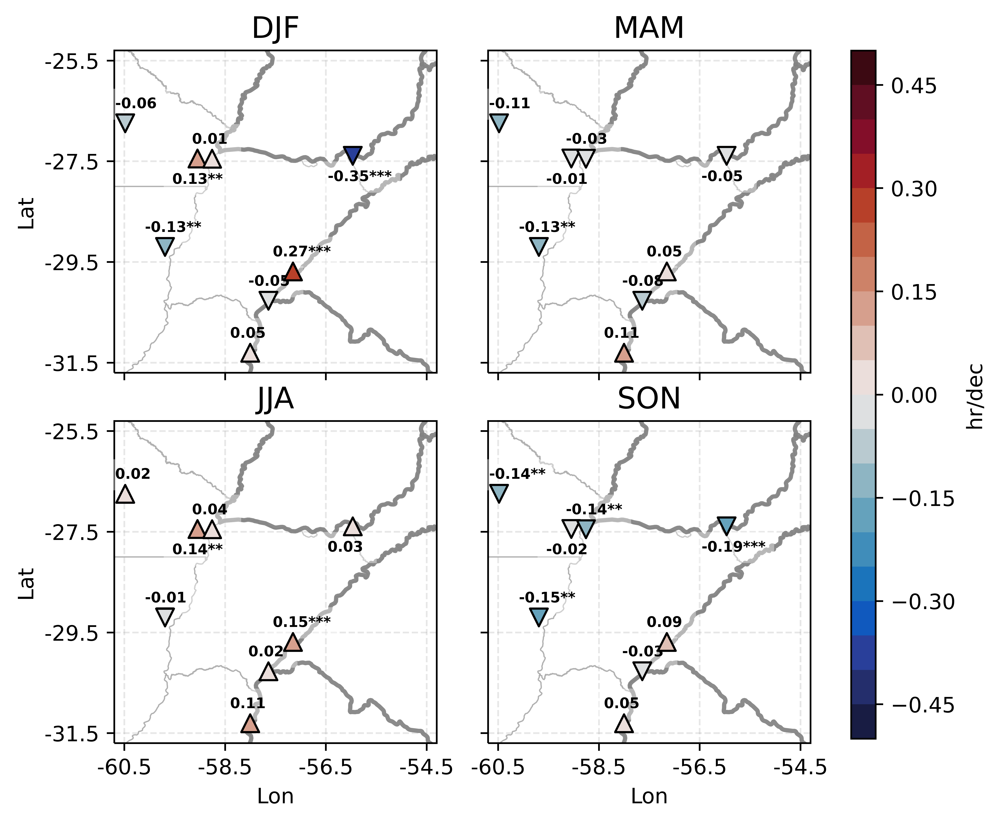

In [21]:
############ 6. MAPA CON TENDENCIAS ESTACIONALES A LARGO PLAZO ##############
fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"

estaciones = ["DJF", "MAM", "JJA", "SON"]
posicion = [221, 222, 223, 224]

lista_puntos_smn_ordenados = [dict_puntos_smn[list(estaciones_ordenadas.keys())[i]] for i in range(0,8)]
dict_puntos_smn_ordenados = zip(estaciones_ordenadas,lista_puntos_smn_ordenados)
lista_puntos_smn_ordenados
list(estaciones_ordenadas.values())[0]    

tendencias_DJF_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[0][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[1][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[2][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[3][i])[1]*10 for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list = [tendencias_DJF_estaciones_ordenadas,
                                           tendencias_MAM_estaciones_ordenadas,
                                           tendencias_JJA_estaciones_ordenadas,
                                           tendencias_SON_estaciones_ordenadas]

#significancias
tendencias_DJF_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[0][i]) for i in range(len(ides_omm_ordenado))]
tendencias_MAM_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[1][i]) for i in range(len(ides_omm_ordenado))]
tendencias_JJA_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[2][i]) for i in range(len(ides_omm_ordenado))]
tendencias_SON_estaciones_ordenadas_significancias = [tendencia_theil_sen(series_medias_estacionales_estaciones_ordenadas_list_2[3][i]) for i in range(len(ides_omm_ordenado))]
tendencias_estaciones_ordenadas_list_significancias = [tendencias_DJF_estaciones_ordenadas_significancias,
                                           tendencias_MAM_estaciones_ordenadas_significancias,
                                           tendencias_JJA_estaciones_ordenadas_significancias,
                                           tendencias_SON_estaciones_ordenadas_significancias]

plot_mapa_tendencias_estaciones()

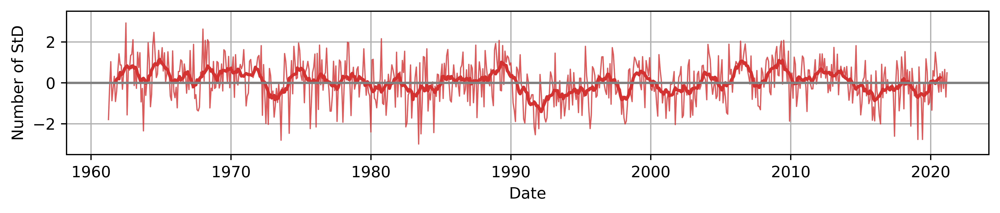

In [22]:
############ 7. ANOMALIAS ESTANDARIZADAS #############

#grafico anomalias estandarizadas con media movil

#Hago media regional, le resto a cada dato la media climatologica del mes correspondiente y lo divido por el desvio
#uso:
#medias_mensuales_smn_media_regional
#medias_mensuales_smn_media_regional_climatologia
#medias_mensuales_smn_media_regional_climatologia_desvio (lo calculo) 
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
medias_mensuales_smn_media_regional.index = pd.to_datetime(medias_mensuales_smn_media_regional.index)
medias_mensuales_smn_media_regional_fechas_climatologia = medias_mensuales_smn_media_regional.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
medias_mensuales_smn_media_regional_climatologia_desvio = medias_mensuales_smn_media_regional_fechas_climatologia.groupby(medias_mensuales_smn_media_regional_fechas_climatologia.index.month).std() 

medias_mensuales_smn_media_regional_anom_list = [None]*12 #lista vacia
for mes in range(1,13):
    medias_mensuales_smn_media_regional_anom_list[mes-1] = (medias_mensuales_smn_media_regional[medias_mensuales_smn_media_regional.index.month==mes]-medias_mensuales_smn_media_regional_climatologia[mes])/medias_mensuales_smn_media_regional_climatologia_desvio[mes]
medias_mensuales_smn_media_regional_anom = pd.concat(medias_mensuales_smn_media_regional_anom_list).sort_index() #ordeno

#calculo media mobil de 12 meses
from f_promedio_movil import f_promedio_movil

def plot_serie_anomalia_media_movil(fecha_inicio, fecha_final):
    #data
    medias_mensuales_smn_media_regional_anom_data = medias_mensuales_smn_media_regional_anom.loc[fecha_inicio:fecha_final]
    ventana = 12
    medias_mensuales_smn_media_regional_anom_media_movil_data = f_promedio_movil(medias_mensuales_smn_media_regional_anom_data, ventana)
    
    fig4b = plt.figure(num=1, figsize=(9, 2), dpi=900)
    plt.subplot(1, 1, 1)
    plt.plot(medias_mensuales_smn_media_regional_anom_data, color = "#D23232", linewidth = 0.8, alpha = 0.8)
    plt.plot(medias_mensuales_smn_media_regional_anom_data.index, medias_mensuales_smn_media_regional_anom_media_movil_data, color = "#D23232", linewidth = 2, alpha = 1)
    plt.ylim((-3.5,3.5))
    plt.ylabel("Number of StD")
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.grid()
    plt.tight_layout()
    #return(fig4b)

#intervalo temporal 1
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
plot_serie_anomalia_media_movil(fecha_inicio_climatologia_str, fecha_final_climatologia_str)
plt.close()

#intervalo temporal 2 March 1961 to February 2021
fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"
plot_serie_anomalia_media_movil(fecha_inicio_str, fecha_final_str)

In [23]:
############ 7. ANOMALIAS ESTANDARIZADAS DE LA MEDIA REGIONAL DE HELIOFANIA Y DE CI: CORRELACION #############
#Abro datos de CI 
import os

ruta_a_ci = "/pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper" #ruta donde se guardan los resultados del analisis de nubosidad
print(f"CHANGE THE WORKING DIRECTORY TO: {ruta_a_ci}")
os.chdir(ruta_a_ci) #se para en ruta general de resultados de nubosidad
print("\n")
print("OPEN TCC_monthly_CI_SMN.csv")
ci = pd.read_csv("TCC_monthly_CI_SMN.csv", index_col="Unnamed: 0")
print("\n")
os.chdir("../../../../../../../../home/nadia.testani/Doctorado/codigos/codigos2023") #codigos/codigos2021/nubosidad")  #VER
cwd = os.getcwd()
print("CHANGE THE WORKING DIRECTORY: {0}".format(cwd))



CHANGE THE WORKING DIRECTORY TO: /pikachu/datos/nadia.testani/Doctorado/resultados/resultados2021/nubosidad/paper


OPEN TCC_monthly_CI_SMN.csv


CHANGE THE WORKING DIRECTORY: /home/nadia.testani/Doctorado/codigos/codigos2023


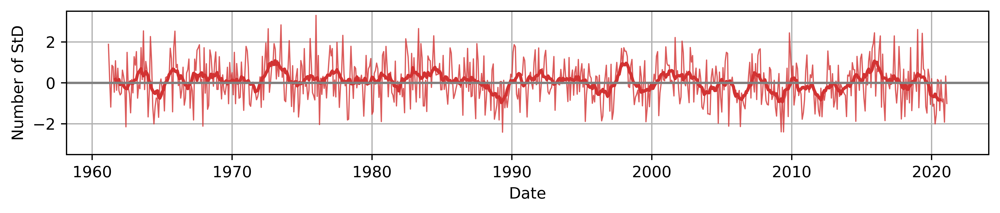

In [24]:
ci_sin_obera = ci[["87148", "87155", "87166", "87178", "87270", "87289", "87393", "87395"]] #sacamos 87187
ci_media_regional = ci_sin_obera.mean(axis = 1)

#calculo media y desvio climatologica
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
ci_media_regional.index = pd.to_datetime(ci_media_regional.index)
ci_medias_mensuales_smn_media_regional_fechas_climatologia = ci_media_regional.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
ci_medias_mensuales_smn_media_regional_climatologia_media = ci_medias_mensuales_smn_media_regional_fechas_climatologia.groupby(ci_medias_mensuales_smn_media_regional_fechas_climatologia.index.month).mean() 
ci_medias_mensuales_smn_media_regional_climatologia_desvio = ci_medias_mensuales_smn_media_regional_fechas_climatologia.groupby(ci_medias_mensuales_smn_media_regional_fechas_climatologia.index.month).std() 

#calculo anomalias estandarizadas de ci
ci_medias_mensuales_smn_media_regional_anom_list = [None]*12 #lista vacia
for mes in range(1,13):
    ci_medias_mensuales_smn_media_regional_anom_list[mes-1] = (ci_media_regional[ci_media_regional.index.month==mes]-ci_medias_mensuales_smn_media_regional_climatologia_media[mes])/ci_medias_mensuales_smn_media_regional_climatologia_desvio[mes]
ci_medias_mensuales_smn_media_regional_anom = pd.concat(ci_medias_mensuales_smn_media_regional_anom_list).sort_index() #ordeno

#lo grafico
#calculo media mobil de 12 meses
from f_promedio_movil import f_promedio_movil

def plot_serie_anomalia_media_movil(fecha_inicio, fecha_final):
    #data
    ci_medias_mensuales_smn_media_regional_anom_data = ci_medias_mensuales_smn_media_regional_anom.loc[fecha_inicio:fecha_final]
    ventana = 12
    ci_medias_mensuales_smn_media_regional_anom_media_movil_data = f_promedio_movil(ci_medias_mensuales_smn_media_regional_anom_data, ventana)
    
    fig4b = plt.figure(num=1, figsize=(9, 2), dpi=900)
    plt.subplot(1, 1, 1)
    plt.plot(ci_medias_mensuales_smn_media_regional_anom_data, color = "#D23232", linewidth = 0.8, alpha = 0.8)
    plt.plot(ci_medias_mensuales_smn_media_regional_anom_data.index, ci_medias_mensuales_smn_media_regional_anom_media_movil_data, color = "#D23232", linewidth = 2, alpha = 1)
    plt.ylim((-3.5,3.5))
    plt.ylabel("Number of StD")
    plt.xlabel("Date")  
    plt.axhline(y=0, color='grey', linestyle='-')
    plt.grid()
    plt.tight_layout()
    #return(fig4b)

#intervalo temporal 1
fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
plot_serie_anomalia_media_movil(fecha_inicio_climatologia_str, fecha_final_climatologia_str)
plt.close()

#intervalo temporal 2 March 1961 to February 2021
fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"
plot_serie_anomalia_media_movil(fecha_inicio_str, fecha_final_str)


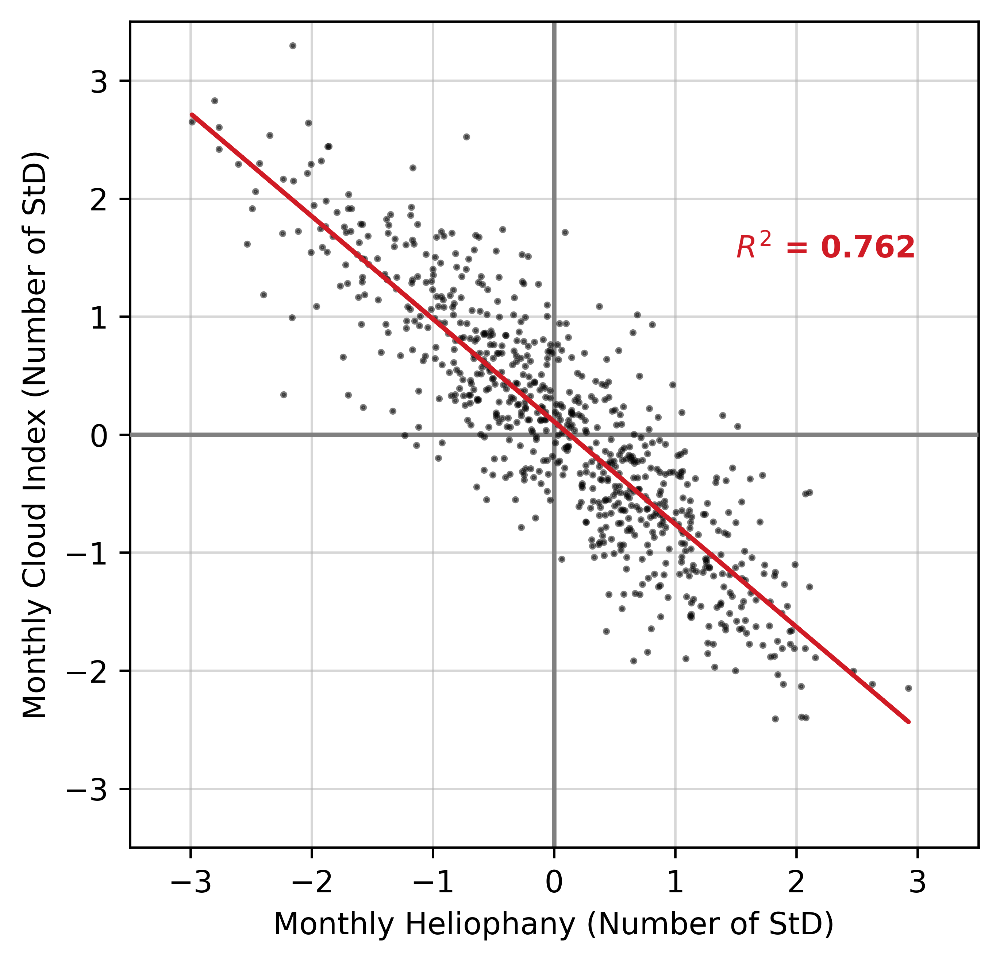

In [25]:
#Ploteo correlacion media regional el el periodo a largo plazo
#datos
fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"

x_1 = medias_mensuales_smn_media_regional_anom[fecha_inicio_str:fecha_final_str].values
y_1 = ci_medias_mensuales_smn_media_regional_anom[fecha_inicio_str:fecha_final_str].values

#calculo recta de regresion
idx = np.isfinite(x_1) & np.isfinite(y_1)
m, b = np.polyfit(x_1[idx], y_1[idx], 1) #m = slope, b=intercept
    
#str con ecuacion
if b > 0:
    ecuacion = f"CI={round(m, 3)}*Heliophany+{round(b,3)}"
elif b == 0:
    ecuacion = f"CI={round(m, 3)}*Heliophany"
else:
    ecuacion = f"CI={round(m, 3)}*Heliophany{round(b,3)}"
    
#calculo R2
correlation = np.corrcoef(x_1[idx], y_1[idx])[0,1]
r_squared = correlation**2

plt.figure(num=1, figsize=(5, 5), dpi=600) #genero figura
ax = plt.gca()

ax.scatter(x_1, y_1, c ="k", alpha = 0.5, marker = ".", s= 7, zorder = 4)
ax.plot(x_1, m*x_1 + b, c = "#D01B25", zorder = 5)
ax.text(1.5, 1.5, '$R^2$ = %0.3f' % r_squared, c= "#D01B25", fontweight = 800, zorder = 6)
#ax.text(-2.5, 10, ecuacion, c= "#D01B25", fontsize = 10, zorder = 6)
ax.hlines(0, xmin = -3.5, xmax = 3.5, color = "grey", zorder = 3)
ax.vlines(0, ymin = -3.5, ymax = 3.5, color = "grey", zorder = 2)

ax.set_xlabel('Monthly Heliophany (Number of StD)')
ax.set_ylabel(f'Monthly Cloud Index (Number of StD)')

plt.ylim(-3.5, 3.5)
plt.xlim(-3.5, 3.5)
ax.grid(alpha = 0.5, zorder = 1)
#ax.annotate(nombre_estacion, (-2.7, 38), size = 17, style='italic', zorder = 7)
#ax.annotate("1961-2021", (-2.7, 37), size = 10, style='italic', zorder = 7)
plt.show()

In [26]:
#veo R2 para cada estacion del año de todas las estaciones
x_1 = medias_mensuales_smn_media_regional_anom[fecha_inicio_str:fecha_final_str]
y_1 = ci_medias_mensuales_smn_media_regional_anom[fecha_inicio_str:fecha_final_str]

x_1.index = pd.date_range(x_1.index[0], x_1.index[-1], freq = "M")
y_1.index = pd.date_range(y_1.index[0], y_1.index[-1] + dt.timedelta(days = 30), freq = "M")
xy = pd.concat([x_1, y_1], axis = 1)
xy.columns = ["helio", "ci"]

#DJF
xy_DJF = xy.loc[(xy.index.month == 12) | (xy.index.month == 1) | (xy.index.month == 2)]
x_DJF = xy_DJF["helio"]
y_DJF = xy_DJF["ci"]
#calculo R2
idx_DJF = np.isfinite(x_DJF) & np.isfinite(y_DJF)
correlation_DJF = np.corrcoef(x_DJF[idx_DJF], y_DJF[idx_DJF])[0,1]
r_squared_DJF = correlation_DJF**2

#MAM
xy_MAM = xy.loc[(xy.index.month == 3) | (xy.index.month == 4) | (xy.index.month == 5)]
x_MAM = xy_MAM["helio"]
y_MAM = xy_MAM["ci"]
#calculo R2
idx_MAM = np.isfinite(x_MAM) & np.isfinite(y_MAM)
correlation_MAM = np.corrcoef(x_MAM[idx_MAM], y_MAM[idx_MAM])[0,1]
r_squared_MAM = correlation_MAM**2

#JJA
xy_JJA = xy.loc[(xy.index.month == 6) | (xy.index.month == 7) | (xy.index.month == 8)]
x_JJA = xy_JJA["helio"]
y_JJA = xy_JJA["ci"]
#calculo R2
idx_JJA = np.isfinite(x_JJA) & np.isfinite(y_JJA)
correlation_JJA = np.corrcoef(x_JJA[idx_JJA], y_JJA[idx_JJA])[0,1]
r_squared_JJA = correlation_JJA**2

#SON
xy_SON = xy.loc[(xy.index.month == 9) | (xy.index.month == 10) | (xy.index.month == 11)]
x_SON = xy_SON["helio"]
y_SON = xy_SON["ci"]
#calculo R2
idx_SON = np.isfinite(x_SON) & np.isfinite(y_SON)
correlation_SON = np.corrcoef(x_SON[idx_SON], y_SON[idx_SON])[0,1]
r_squared_SON = correlation_SON**2

rs = pd.DataFrame([r_squared_DJF, r_squared_MAM,r_squared_JJA, r_squared_SON], 
                 ["DJF", "MAM", "JJA", "SON"])

rs = round(rs, 3)
print(rs)


         0
DJF  0.692
MAM  0.837
JJA  0.791
SON  0.734


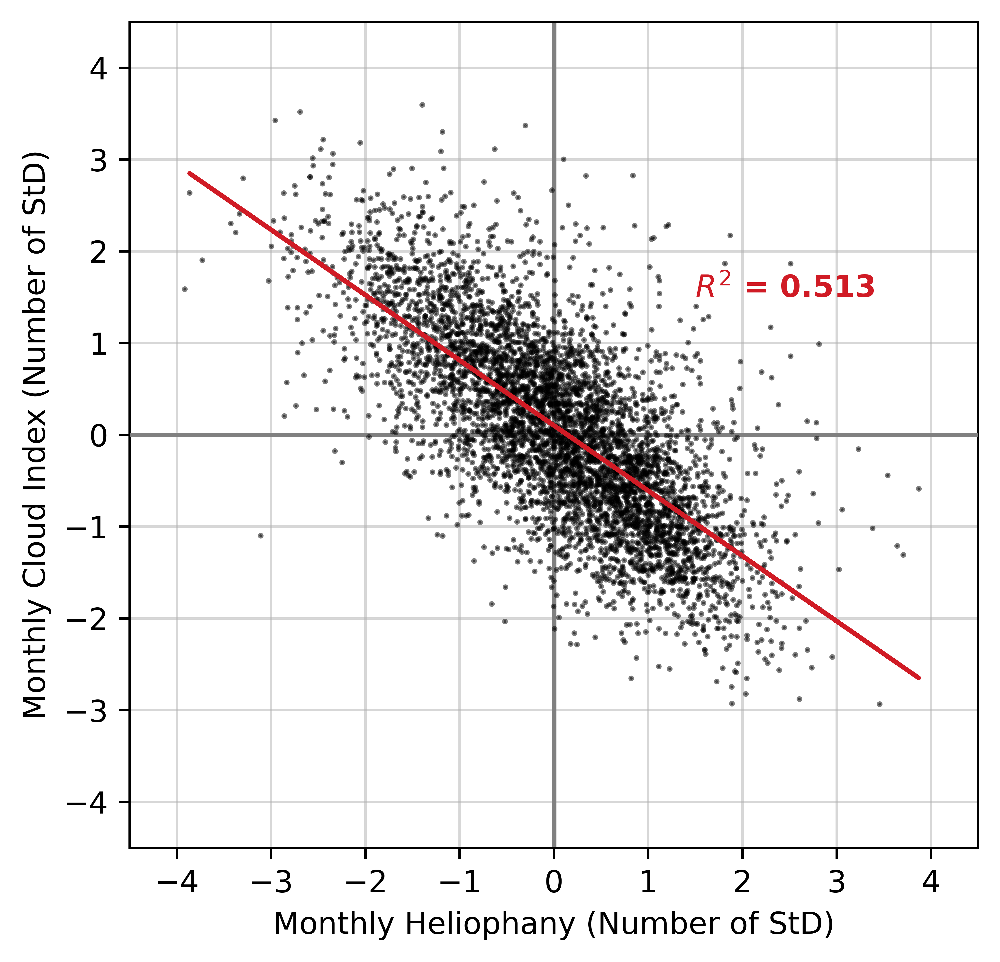

,,DJF,MAM,JJA,SON
87148,0,0.533,0.628,0.699,0.646
87155,0,0.333,0.561,0.530,0.491
87166,0,0.633,0.745,0.646,0.702
87178,0,0.083,0.594,0.590,0.326
87270,0,0.237,0.566,0.495,0.415
87289,0,0.539,0.662,0.616,0.512
87393,0,0.705,0.784,0.734,0.648
87395,0,0.457,0.598,0.596,0.589


In [29]:
#ploteo correlacion todas las estaciones
#calculo anomalias estandarizadas de cada estacion de ambas variables y las grafico

def anom_estandarizada_ci(serie, fecha_inicio_climatologia_str, fecha_final_climatologia_str ):
    """
    serie: serie temporal mensual o diaria como dataframe
    las fechas son para la climatologia: media y desvio a partir del que se calculan las anomalias
    """
    #if type(serie.index) != pd.core.indexes.datetimes.DatetimeIndex:
    serie.index = pd.to_datetime(serie.index)
    serie_fechas_climatologia = serie.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    serie_climatologia_media = serie_fechas_climatologia.groupby(serie_fechas_climatologia.index.month).mean() 
    serie_climatologia_desvio = serie_fechas_climatologia.groupby(serie_fechas_climatologia.index.month).std() 
    #anomalia estandarizada
    serie_anom_list = [None]*12 #lista vacia
    for mes in range(1,13):
        serie_anom_list[mes-1] = (serie[serie.index.month==mes]-serie_climatologia_media[mes])/serie_climatologia_desvio[mes]
    serie_anom = pd.concat(serie_anom_list).sort_index() #ordeno
    return(serie_anom)

fecha_inicio_climatologia_str = "1983-12-01"
fecha_final_climatologia_str = "2016-11-30"
fecha_inicio_str = "1961-03-01"
fecha_final_str = "2021-02-28"
ci_anom_estandarizadas = {}
#selecciono las fechas de fecha_inicio_str y fecha_final_str
for ide in ides_omm_ordenado:
    ci_estacion = ci_sin_obera[str(ide)]
    ci_anom_estandarizadas[ide] = anom_estandarizada_ci(ci_estacion, fecha_inicio_climatologia_str, fecha_final_climatologia_str)[fecha_inicio_str:fecha_final_str]

def anom_estandarizada_helio(serie, fecha_inicio_climatologia_str, fecha_final_climatologia_str ):
    """
    serie: serie temporal mensual o diaria como dataframe
    las fechas son para la climatologia: media y desvio a partir del que se calculan las anomalias
    """
    #if type(serie.index) != pd.core.indexes.datetimes.DatetimeIndex:
    serie.index = pd.to_datetime(serie.index)
    serie_fechas_climatologia = serie.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
    serie_climatologia_media = serie_fechas_climatologia.groupby(serie_fechas_climatologia.index.month).mean() 
    serie_climatologia_desvio = serie_fechas_climatologia.groupby(serie_fechas_climatologia.index.month).std() 
    #anomalia estandarizada
    serie_anom_list = [None]*12 #lista vacia
    for mes in range(1,13):
        serie_anom_list[mes-1] = (serie[serie.index.month==mes]-serie_climatologia_media.loc[mes])/serie_climatologia_desvio.loc[mes]
    serie_anom = pd.concat(serie_anom_list).sort_index() #ordeno
    return(serie_anom)

helio_anom_estandarizadas = {}
#selecciono las fechas de fecha_inicio_str y fecha_final_str
for ide in ides_omm_ordenado:
    helio_estacion = medias_mensuales_smn[ide]
    helio_anom_estandarizadas[ide] = anom_estandarizada_helio(helio_estacion, fecha_inicio_climatologia_str, fecha_final_climatologia_str)[fecha_inicio_str:fecha_final_str]

#armo dict con dataframes de anomalias de helio y ci juntas
helio_y_ci_anom_estandarizadas = {}
for ide in ides_omm_ordenado:
    helio_anom_estandarizadas[ide][0].index = pd.date_range(helio_anom_estandarizadas[ide][0].index[0], helio_anom_estandarizadas[ide][0].index[-1], freq = "M")
    ci_anom_estandarizadas[ide].index = pd.date_range(ci_anom_estandarizadas[ide].index[0], ci_anom_estandarizadas[ide].index[-1] + dt.timedelta(days = 30), freq = "M")
    helio_y_ci = pd.concat([helio_anom_estandarizadas[ide][0], ci_anom_estandarizadas[ide]], axis = 1)
    helio_y_ci.columns = ["helio", "ci"]
    helio_y_ci_anom_estandarizadas[ide] = helio_y_ci

#las grafico
xy = pd.concat(helio_y_ci_anom_estandarizadas)
x = xy["helio"]
y = xy["ci"]

#calculo recta de regresion
idx = np.isfinite(x) & np.isfinite(y)
m, b = np.polyfit(x[idx], y[idx], 1) #m = slope, b=intercept

#calculo R2
correlation = np.corrcoef(x[idx], y[idx])[0,1]
r_squared = correlation**2

plt.figure(num=1, figsize=(5, 5), dpi=900) #genero figura
ax = plt.gca()
ax.scatter(x, y, c ="k", alpha = 0.5, marker = ".", s= 3, zorder = 4)
ax.plot(x, m*x + b, c = "#D01B25", zorder = 5)
ax.text(1.5, 1.5, '$R^2$ = %0.3f' % r_squared, c= "#D01B25", fontweight = 800, zorder = 6)
#ax.text(-2.5, 10, ecuacion, c= "#D01B25", fontsize = 10, zorder = 6)
ax.hlines(0, xmin = -4.5, xmax = 4.5, color = "grey", zorder = 3)
ax.vlines(0, ymin = -4.5, ymax = 4.5, color = "grey", zorder = 2)
ax.set_xlabel('Monthly Heliophany (Number of StD)')
ax.set_ylabel(f'Monthly Cloud Index (Number of StD)')
plt.ylim(-4.5, 4.5)
plt.xlim(-4.5, 4.5)
ax.grid(alpha = 0.5, zorder = 1)
plt.show()


#veo el R2 de cada estacion
corr_coef_estaciones_ci_helio = {}
for ide in ides_omm_ordenado:
    xy = helio_y_ci_anom_estandarizadas[ide]
    x = xy["helio"]
    y = xy["ci"]
    #calculo R2
    idx = np.isfinite(x) & np.isfinite(y)
    correlation = np.corrcoef(x[idx], y[idx])[0,1]
    r_squared = correlation**2
    corr_coef_estaciones_ci_helio[ide] = round(r_squared,3)
corr_coef_estaciones_ci_helio

#veo el R2 de cada estacion para cada estacion del año
corr_coef_estaciones_ci_helio_estacionales = {}
for ide in ides_omm_ordenado:
    xy = helio_y_ci_anom_estandarizadas[ide]
    #DJF
    xy_DJF = xy.loc[(xy.index.month == 12) | (xy.index.month == 1) | (xy.index.month == 2)]
    x_DJF = xy_DJF["helio"]
    y_DJF = xy_DJF["ci"]
    #calculo R2
    idx_DJF = np.isfinite(x_DJF) & np.isfinite(y_DJF)
    correlation_DJF = np.corrcoef(x_DJF[idx_DJF], y_DJF[idx_DJF])[0,1]
    r_squared_DJF = correlation_DJF**2

    #MAM
    xy_MAM = xy.loc[(xy.index.month == 3) | (xy.index.month == 4) | (xy.index.month == 5)]
    x_MAM = xy_MAM["helio"]
    y_MAM = xy_MAM["ci"]
    #calculo R2
    idx_MAM = np.isfinite(x_MAM) & np.isfinite(y_MAM)
    correlation_MAM = np.corrcoef(x_MAM[idx_MAM], y_MAM[idx_MAM])[0,1]
    r_squared_MAM = correlation_MAM**2

    #JJA
    xy_JJA = xy.loc[(xy.index.month == 6) | (xy.index.month == 7) | (xy.index.month == 8)]
    x_JJA = xy_JJA["helio"]
    y_JJA = xy_JJA["ci"]
    #calculo R2
    idx_JJA = np.isfinite(x_JJA) & np.isfinite(y_JJA)
    correlation_JJA = np.corrcoef(x_JJA[idx_JJA], y_JJA[idx_JJA])[0,1]
    r_squared_JJA = correlation_JJA**2

    #SON
    xy_SON = xy.loc[(xy.index.month == 9) | (xy.index.month == 10) | (xy.index.month == 11)]
    x_SON = xy_SON["helio"]
    y_SON = xy_SON["ci"]
    #calculo R2
    idx_SON = np.isfinite(x_SON) & np.isfinite(y_SON)
    correlation_SON = np.corrcoef(x_SON[idx_SON], y_SON[idx_SON])[0,1]
    r_squared_SON = correlation_SON**2

    rs = pd.DataFrame([r_squared_DJF, r_squared_MAM,r_squared_JJA, r_squared_SON], 
                     ["DJF", "MAM", "JJA", "SON"])
    corr_coef_estaciones_ci_helio_estacionales[ide] = round(rs, 3)

tabla_rs_estacionales = pd.concat(corr_coef_estaciones_ci_helio_estacionales, axis = 1)
tabla_rs_estacionales.transpose()


In [30]:
#veo R2 para cada estacion del año de todas las estaciones
xy = pd.concat(helio_y_ci_anom_estandarizadas)
xy.index = xy.index.droplevel(-2)

#DJF
xy_DJF = xy.loc[(xy.index.month == 12) | (xy.index.month == 1) | (xy.index.month == 2)]
x_DJF = xy_DJF["helio"]
y_DJF = xy_DJF["ci"]
#calculo R2
idx_DJF = np.isfinite(x_DJF) & np.isfinite(y_DJF)
correlation_DJF = np.corrcoef(x_DJF[idx_DJF], y_DJF[idx_DJF])[0,1]
r_squared_DJF = correlation_DJF**2

#MAM
xy_MAM = xy.loc[(xy.index.month == 3) | (xy.index.month == 4) | (xy.index.month == 5)]
x_MAM = xy_MAM["helio"]
y_MAM = xy_MAM["ci"]
#calculo R2
idx_MAM = np.isfinite(x_MAM) & np.isfinite(y_MAM)
correlation_MAM = np.corrcoef(x_MAM[idx_MAM], y_MAM[idx_MAM])[0,1]
r_squared_MAM = correlation_MAM**2

#JJA
xy_JJA = xy.loc[(xy.index.month == 6) | (xy.index.month == 7) | (xy.index.month == 8)]
x_JJA = xy_JJA["helio"]
y_JJA = xy_JJA["ci"]
#calculo R2
idx_JJA = np.isfinite(x_JJA) & np.isfinite(y_JJA)
correlation_JJA = np.corrcoef(x_JJA[idx_JJA], y_JJA[idx_JJA])[0,1]
r_squared_JJA = correlation_JJA**2

#SON
xy_SON = xy.loc[(xy.index.month == 9) | (xy.index.month == 10) | (xy.index.month == 11)]
x_SON = xy_SON["helio"]
y_SON = xy_SON["ci"]
#calculo R2
idx_SON = np.isfinite(x_SON) & np.isfinite(y_SON)
correlation_SON = np.corrcoef(x_SON[idx_SON], y_SON[idx_SON])[0,1]
r_squared_SON = correlation_SON**2

rs = pd.DataFrame([r_squared_DJF, r_squared_MAM,r_squared_JJA, r_squared_SON], 
                 ["DJF", "MAM", "JJA", "SON"])

rs = round(rs, 3)
print(rs)

         0
DJF  0.355
MAM  0.624
JJA  0.600
SON  0.510


In [ ]:
############FIN###################
#Lo que sigue son cosas que por ahi me sirvan en algun momento

############# 4. SERIES MENSUALES --> CLIMATOLOGIAS#############
#fecha_inicio_climatologia_str = "1983-12-01"
#fecha_final_climatologia_str = "2016-11-30"

##calculo la climatologia de las medias mensualesUnnamed: 0
#climatologia_medias_mensuales_smn = {} 
#for id_omm in tabla_info_estaciones["Code"]: #para cada id_omm_ordenado
#    media_mensual_df = medias_mensuales_smn[id_omm]
#    media_mensual_df.index = pd.to_datetime(media_mensual_df.index)
#    media_mensual_fechas_climatologia = media_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
#    media_mensual_climatologia = media_mensual_fechas_climatologia.groupby(media_mensual_fechas_climatologia.index.month).mean() 
#    #Lo guardo en diccionario: climatologia_medias_mensuales
#    climatologia_medias_mensuales_smn[id_omm] = media_mensual_climatologia
#
#climatologia_medias_mensuales_smn
#
##calculo series de desvio estandar mensuales de cada estacion
##los meses con mas de 20% de datos faltantes se computan como NA
#from f_desvio_mensual_smn import f_desvio_mensual_smn 
#
#porcentaje_na_admitido = 20
#desvios_mensuales_smn = {} #genero diccionario donde se van a guardar las medias mensuales
##para cada id_omm_ordenado
#for id_omm in tabla_info_estaciones["Code"]:
#    desvio_mensual_df = f_desvio_mensual_smn(id_omm, datos_smn[id_omm], porcentaje_na_admitido, "helio") #uso funcion f_media_mensual_smn en f_paper_nubosidad_NEA
#    desvios_mensuales_smn[id_omm] = desvio_mensual_df
#
##calculo la climatologia de los devios mensuales
#climatologia_desvios_mensuales_smn = {} 
#for id_omm in tabla_info_estaciones["Code"]: #para cada id_omm_ordenado
#    desvio_mensual_df = desvios_mensuales_smn[id_omm]
#    desvio_mensual_df.index = pd.to_datetime(desvio_mensual_df.index)
#    desvio_mensual_fechas_climatologia = desvio_mensual_df.loc[fecha_inicio_climatologia_str:fecha_final_climatologia_str]
#    desvio_mensual_climatologia = desvio_mensual_fechas_climatologia.groupby(desvio_mensual_fechas_climatologia.index.month).mean() 
#    #Lo guardo en diccionario: climatologia_medias_mensuales
#    climatologia_desvios_mensuales_smn[id_omm] = desvio_mensual_climatologia
